<a href="https://colab.research.google.com/github/samuhin/TimeSeries/blob/main/TimeSeries.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Установка и импортирование библиотек

##Устанавливаем нестандартные библиотеки

###Библиотека для работы с котировками

In [1]:
!pip install yfinance

###Библиотека для работы с метриками

In [2]:
!pip install ml_metrics

##Импортируем основные библиотеки

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import yfinance
from matplotlib import pyplot
from pandas import read_csv
from pandas import DataFrame
from pandas import concat
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.models import Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Dropout
from keras.layers import LSTM
from keras.layers import GRU
from keras.layers import SimpleRNN
from sklearn.linear_model import LinearRegression

##Конфигурация для получения изображений высокой чёткости

In [4]:
%config InlineBackend.figure_format = 'retina'

#Загрузка данных и предобработка данных

##Загрузка

Выбираем временной промежуток

In [5]:
start_date = '2017-01-01'
end_date = '2020-12-31'

Загружаем данные

In [6]:
 data = yfinance.download("AUDUSD=X CADUSD=X CHFUSD=X \
                          CNYUSD=X DKKUSD=X EURUSD=X \
                          GBPUSD=X HKDUSD=X JPYUSD=X \
                          KZTUSD=X NOKUSD=X NZDUSD=X \
                          PLNUSD=X RUBUSD=X SEKUSD=X",
                        start=start_date, end=end_date)

[*********************100%***********************]  15 of 15 completed


Посмотрим на скачанные данные (закрытие)

In [7]:
 data['Close'].head()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
Date,,,,,,,,,,,,,,,
2017-01-02,0.720981,0.744380,0.981653,0.144013,0.141589,1.052698,1.234903,0.128949,0.008562,0.003012,0.115845,0.693433,0.239261,0.016332,0.110110
2017-01-03,0.719683,0.743970,0.976381,0.144009,0.140689,1.046003,1.228199,0.128901,0.008511,0.003022,0.115547,0.693193,0.237208,0.016332,0.109632
2017-01-04,0.722993,0.745057,0.974564,0.143682,0.140155,1.041992,1.224560,0.128927,0.008499,0.003028,0.115737,0.692377,0.237595,0.016414,0.109269
2017-01-05,0.728704,0.751936,0.980277,0.144402,0.141231,1.050089,1.232681,0.128950,0.008539,0.003036,0.116524,0.696330,0.240393,0.016566,0.109964
2017-01-06,0.733837,0.755892,0.990305,0.145182,0.142680,1.060592,1.242545,0.128959,0.008676,0.003062,0.117927,0.702149,0.243142,0.016835,0.111151


Посмотрим описание данных

In [8]:
 data['Close'].describe()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
count,1021.000000,1021.000000,1021.000000,1020.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000
mean,0.725972,0.760871,1.028447,0.147448,0.153501,1.144000,1.297346,0.128135,0.009128,0.002769,0.116271,0.679164,0.265455,0.015635,0.112031
std,0.042692,0.022069,0.033005,0.004888,0.006193,0.045590,0.046177,0.000614,0.000233,0.000281,0.007867,0.034528,0.013252,0.001421,0.006710
min,0.574290,0.689741,0.974564,0.139315,0.140155,1.041992,1.149439,0.127369,0.008499,0.002201,0.085035,0.562610,0.233536,0.012358,0.095797
25%,0.697204,0.749176,1.005429,0.144161,0.149027,1.112929,1.268875,0.127514,0.008950,0.002592,0.111079,0.657138,0.258160,0.014896,0.106778
50%,0.723589,0.759359,1.019056,0.145966,0.152488,1.137540,1.296512,0.128008,0.009113,0.002679,0.116989,0.678509,0.264643,0.015673,0.111624
75%,0.758743,0.772917,1.040139,0.150578,0.158213,1.177745,1.320795,0.128810,0.009298,0.003037,0.122119,0.704072,0.272327,0.016909,0.115864
max,0.811688,0.825948,1.134327,0.159551,0.168059,1.251001,1.434206,0.129039,0.009698,0.003263,0.130875,0.752570,0.301181,0.017976,0.127521


##Предобработка

Заполним пропуски в данных

In [9]:
 new_data = data['Close'].interpolate(method='polynomial', order=3)

Посмотрим на результаты заполнения

In [10]:
 new_data.describe()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
count,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000
mean,0.725972,0.760871,1.028447,0.147444,0.153501,1.144000,1.297346,0.128135,0.009128,0.002769,0.116271,0.679164,0.265455,0.015635,0.112031
std,0.042692,0.022069,0.033005,0.004888,0.006193,0.045590,0.046177,0.000614,0.000233,0.000281,0.007867,0.034528,0.013252,0.001421,0.006710
min,0.574290,0.689741,0.974564,0.139315,0.140155,1.041992,1.149439,0.127369,0.008499,0.002201,0.085035,0.562610,0.233536,0.012358,0.095797
25%,0.697204,0.749176,1.005429,0.144161,0.149027,1.112929,1.268875,0.127514,0.008950,0.002592,0.111079,0.657138,0.258160,0.014896,0.106778
50%,0.723589,0.759359,1.019056,0.145964,0.152488,1.137540,1.296512,0.128008,0.009113,0.002679,0.116989,0.678509,0.264643,0.015673,0.111624
75%,0.758743,0.772917,1.040139,0.150577,0.158213,1.177745,1.320795,0.128810,0.009298,0.003037,0.122119,0.704072,0.272327,0.016909,0.115864
max,0.811688,0.825948,1.134327,0.159551,0.168059,1.251001,1.434206,0.129039,0.009698,0.003263,0.130875,0.752570,0.301181,0.017976,0.127521


#Подготовка к анализу данных как временного ряда

Напишем функция для преобразование данных в удобную форму для работы с ними

In [11]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

Введём дополнительные регрессоры (если нужно)

In [12]:
#new_data['day'] = new_data.index.day
#new_data['month'] = new_data.index.month

Переведём данные в numpy-массив:

In [13]:
values = new_data.values
values

array([[0.72098053, 0.74437994, 0.98165292, ..., 0.23926078, 0.01633152,
        0.11011021],
       [0.71968335, 0.7439701 , 0.97638136, ..., 0.23720796, 0.01633232,
        0.1096323 ],
       [0.7229926 , 0.74505657, 0.97456384, ..., 0.2375946 , 0.01641416,
        0.10926872],
       ...,
       [0.7588923 , 0.77881616, 1.12574577, ..., 0.27210575, 0.01352622,
        0.1210579 ],
       [0.76098984, 0.77990347, 1.13109374, ..., 0.26990852, 0.01350961,
        0.12188224],
       [0.76892906, 0.7842707 , 1.13432705, ..., 0.2686179 , 0.01341886,
        0.12211846]])

Посмотрим какая у него размерность

In [14]:
values.shape 

(1021, 15)

Сделаем преобразование MinMaxScale для данных

In [15]:
# ensure all data is float
values = values.astype('float32')
# normalize features
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(values)

Посмотрим что получилось:

In [16]:
 scaled

array([[0.6179085 , 0.4011469 , 0.04437256, ..., 0.08463311, 0.7072511 ,
        0.45117784],
       [0.6124444 , 0.39813805, 0.01137638, ..., 0.05428648, 0.70739365,
        0.4361136 ],
       [0.626384  , 0.40611458, 0.        , ..., 0.06000233, 0.7219608 ,
        0.4246533 ],
       ...,
       [0.77760553, 0.6539693 , 0.94628763, ..., 0.57017875, 0.20794702,
        0.796262  ],
       [0.7864411 , 0.661952  , 0.9797621 , ..., 0.5376971 , 0.20499039,
        0.8222463 ],
       [0.8198838 , 0.6940155 , 1.        , ..., 0.5186181 , 0.18883777,
        0.8296921 ]], dtype=float32)

#Разделение выборки на обучающую, тестовую и валидационную

Посмотрим сколько у нас всего единиц времени

In [17]:
len(values)

1021

Настроим параметры и поделим

In [18]:
def split(n_previous, n_predict, train_per, val_per):
  # specify the number of lag hours
  n_hours = n_previous
  n_features = scaled.shape[1]
  n_predict = n_predict

  # frame as supervised learning
  reframed = series_to_supervised(scaled, n_hours, n_predict)

  # split into train and test sets
  values = reframed.values

  n_train_hours = int(len(values) * train_per)
  n_val_hours = int(len(values) * val_per)

  train = values[:n_train_hours, :]
  test = values[n_train_hours:-n_val_hours, :]
  valid = values[-n_val_hours:, :]

  # split into input and outputs
  n_obs = n_hours * n_features
  train_X, train_y = train[:, :n_obs], train[:, n_obs:]
  test_X, test_y = test[:, :n_obs], test[:, n_obs:]
  valid_X, valid_y = valid[:, :n_obs], valid[:, n_obs:]

  # reshape input to be 3D [samples, timesteps, features]
  train_X = train_X.reshape((train_X.shape[0], n_hours, n_features))
  test_X = test_X.reshape((test_X.shape[0], n_hours, n_features))
  valid_X = valid_X.reshape((valid_X.shape[0], n_hours, n_features))
  return (train_X, test_X, valid_X, train_y, test_y, valid_y)

In [19]:
train_X, test_X, valid_X, train_y, test_y, valid_y = split(3, 1, 0.6, 0.15)

#Анализ

##Метрики

Импортируем библиотеку

In [20]:
import ml_metrics as metrics

###MSE

In [21]:
def MSE(y_hat, y_pred):
  pass
  return metrics.mse(y_hat, y_pred)

###RMSE

In [22]:
def RMSE(y_hat, y_pred):
  pass
  return metrics.rmse(y_hat, y_pred)

###MAE

In [23]:
def MAE(y_hat, y_pred):
  pass
  return metrics.mae(y_hat, y_pred)

##Создаём таблицу результатов

In [24]:
table = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE'])
table

,MSE,RMSE,MAE


##Наивный алгоритм

####Вычисления

Составляем предсказание

In [25]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.concatenate((temp_pred, np.array([temp_pred[-n:][-1]])))
    y_pred.append(temp_pred[-1])
  i = i + n

Выполяем обратное преобразование

In [26]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим график предсказания

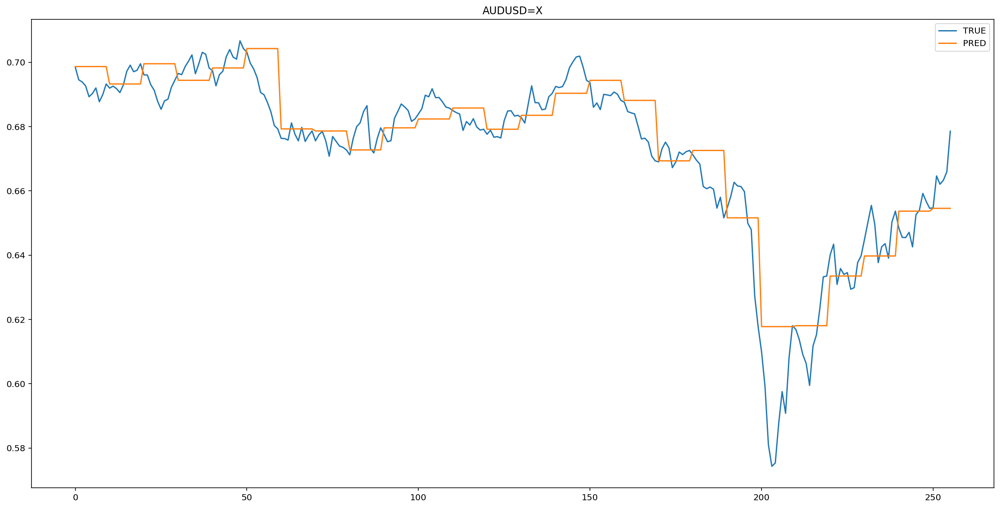

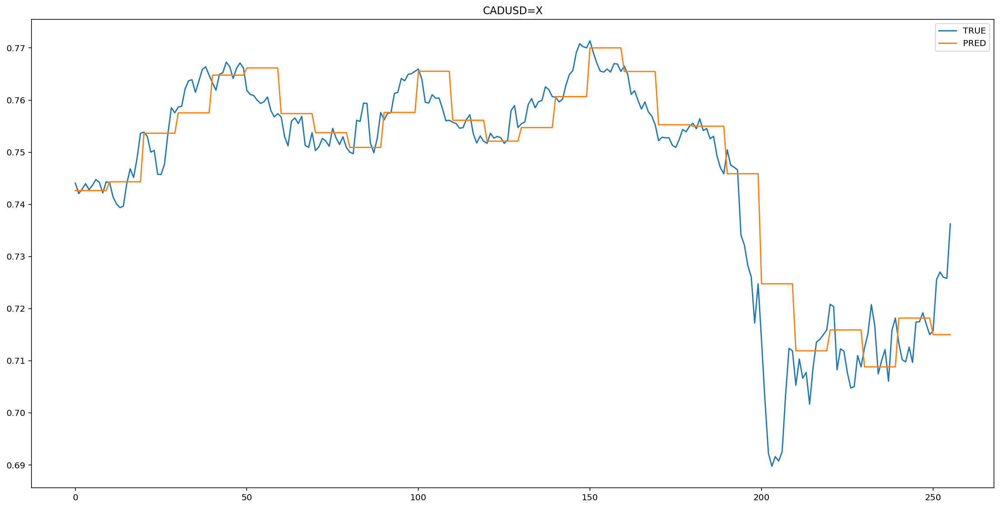

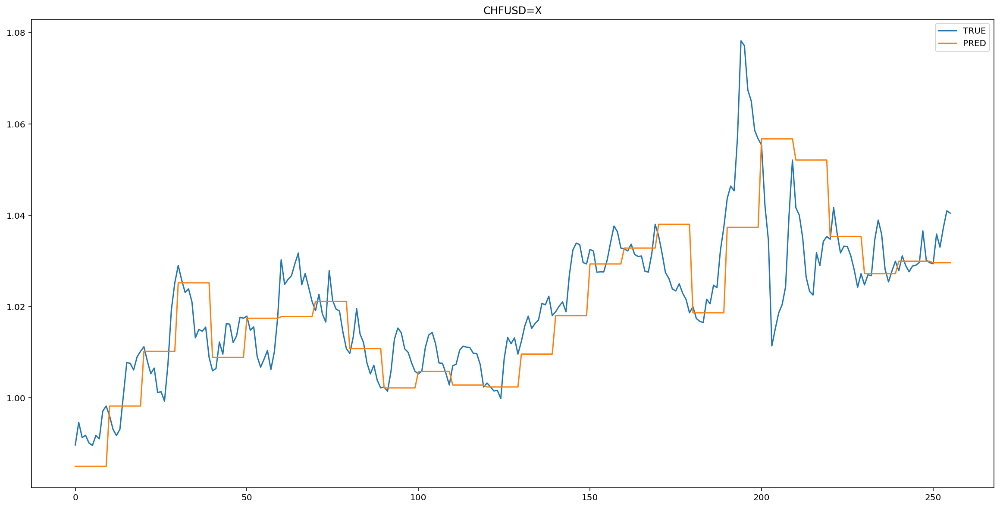

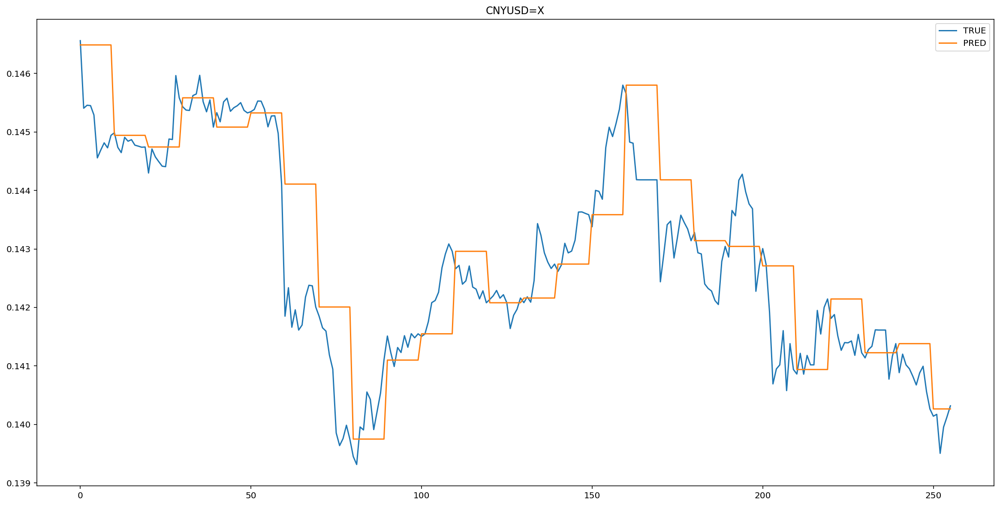

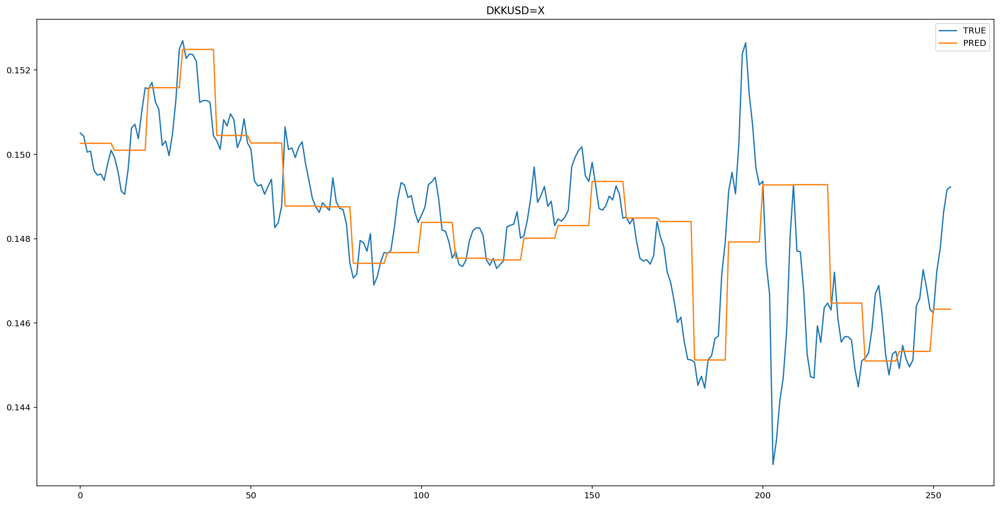

...

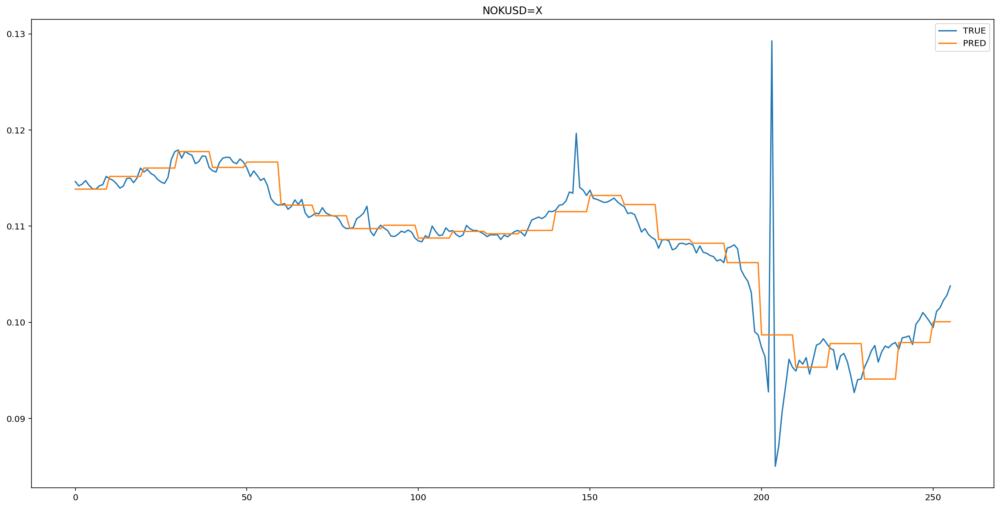

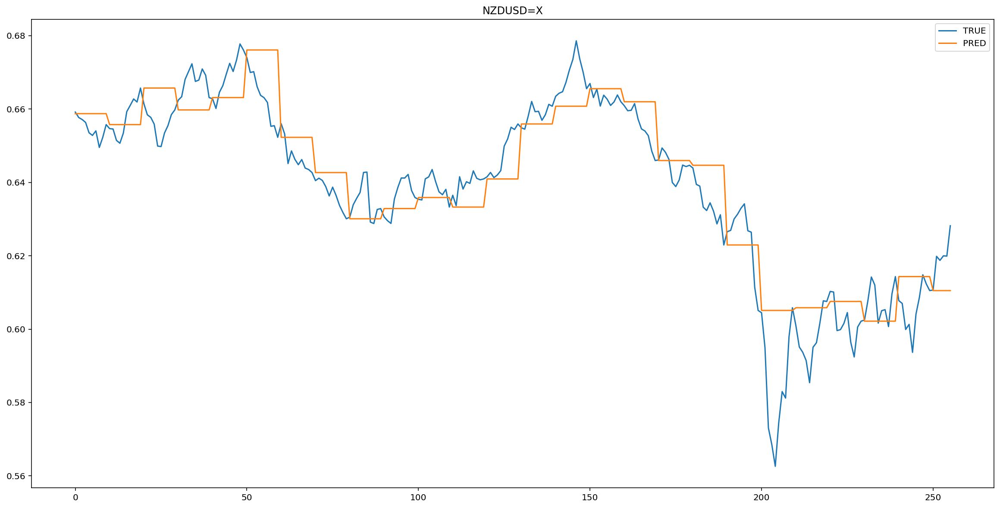

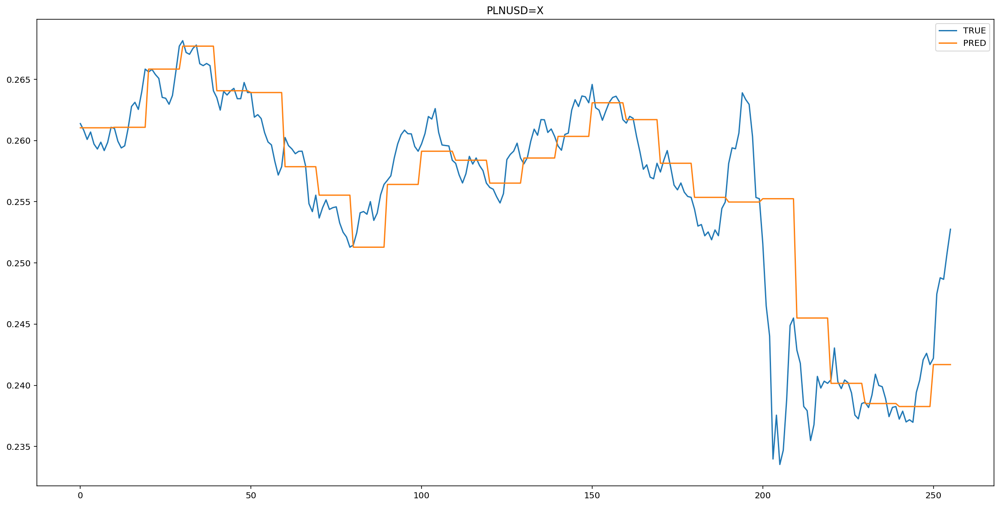

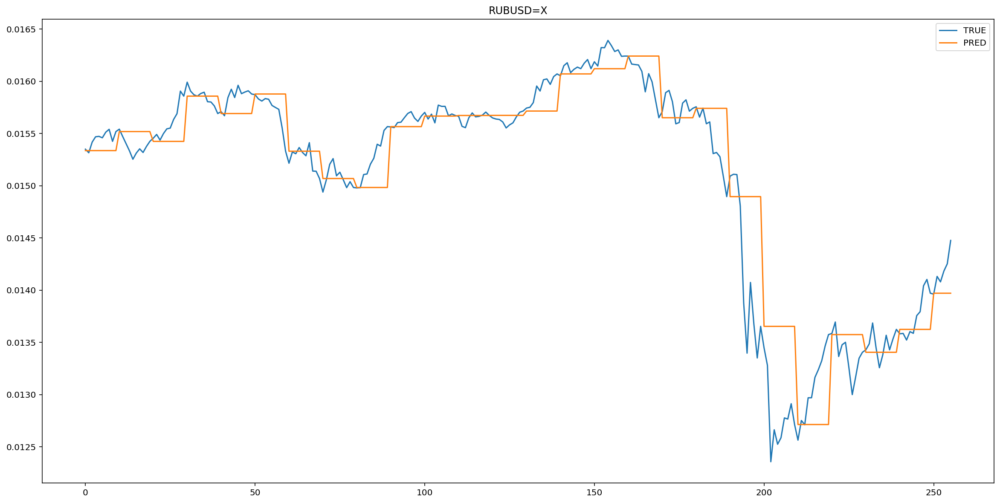

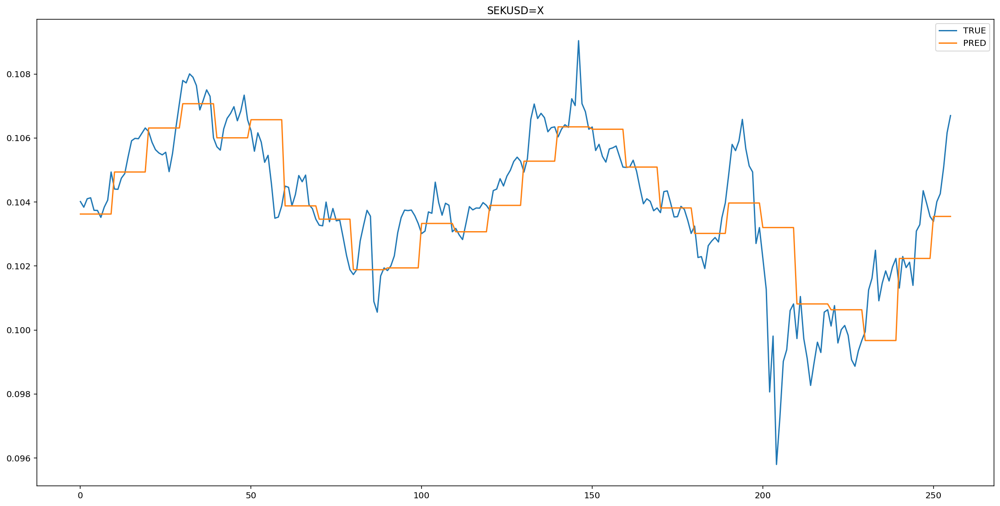

In [27]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

###Оцениваем точность

In [28]:
table.loc['naive'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [29]:
MSE(y_hat, y_pred)

5.8025744e-05

In [30]:
RMSE(y_hat, y_pred)

0.007617463

In [31]:
MAE(y_hat, y_pred)

0.0036440634

##Среднее

###Простое среднее

####Вычисления

Составляем предсказание

In [32]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.array([temp_pred[-n:].mean(axis = 0)]) #простое среднее
    y_pred.append(temp_pred[-1])
  i = i + n

Делаем обратное предсказание

In [33]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим графики

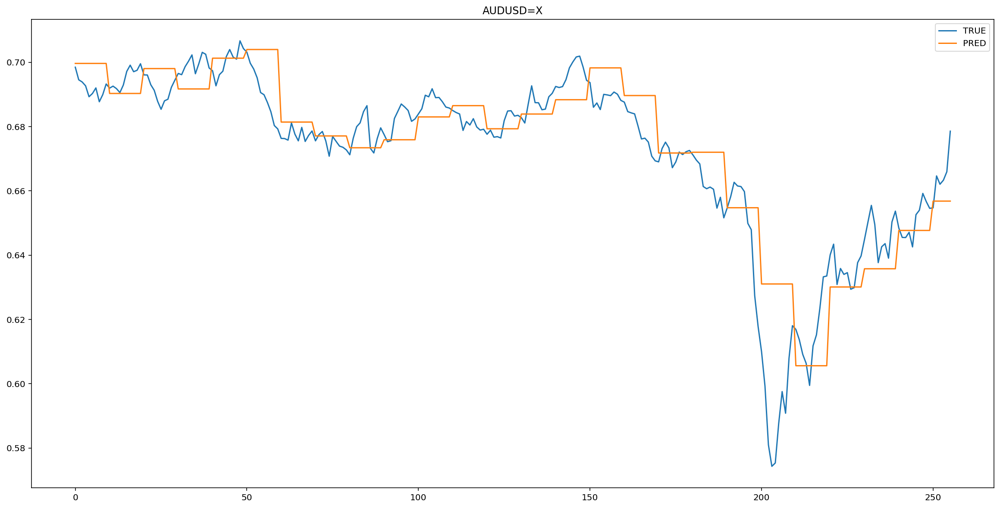

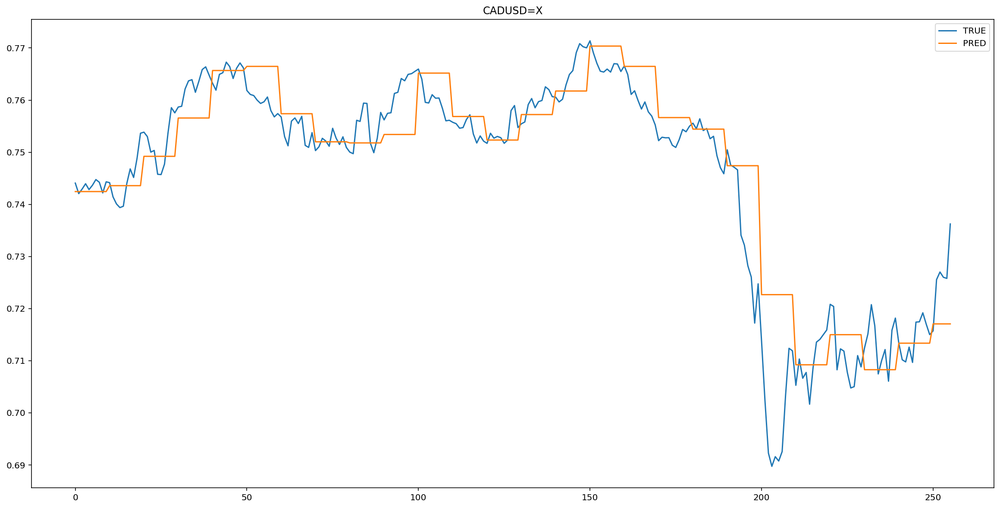

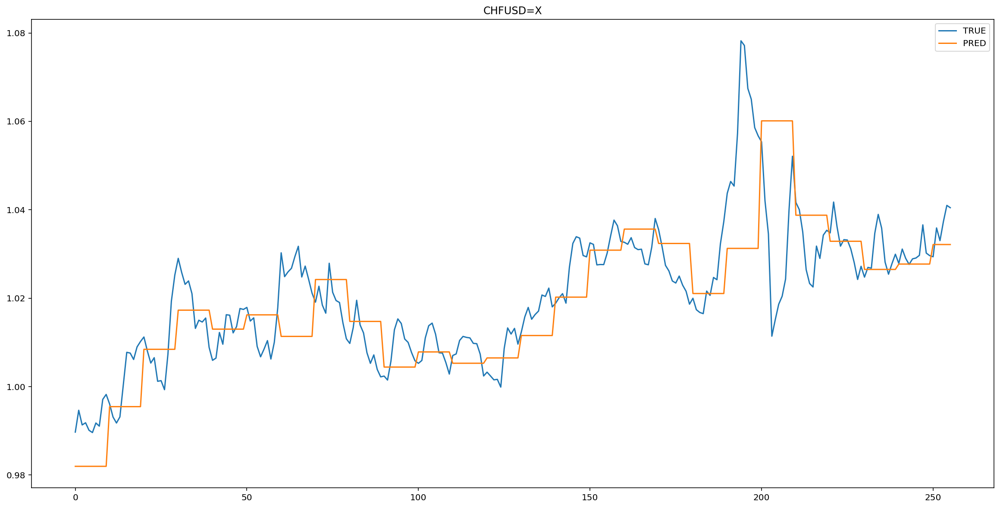

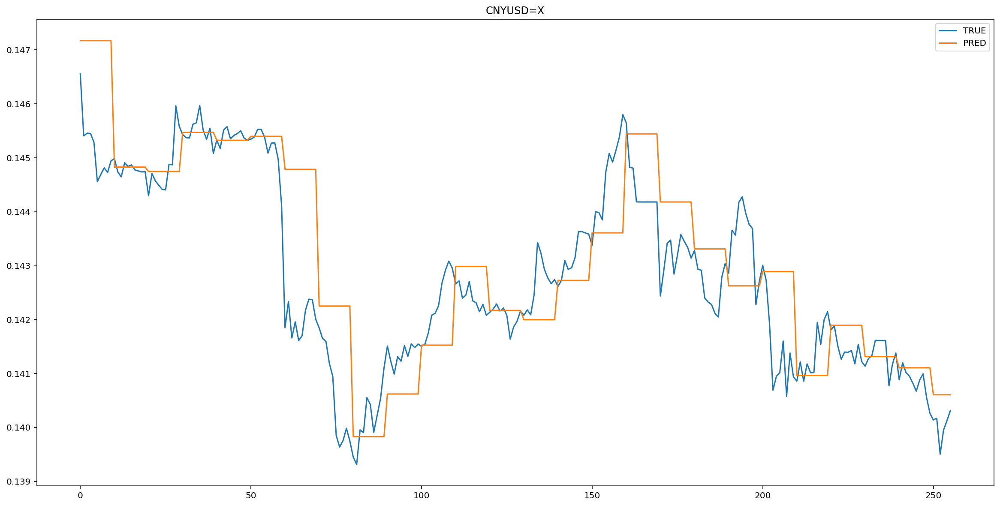

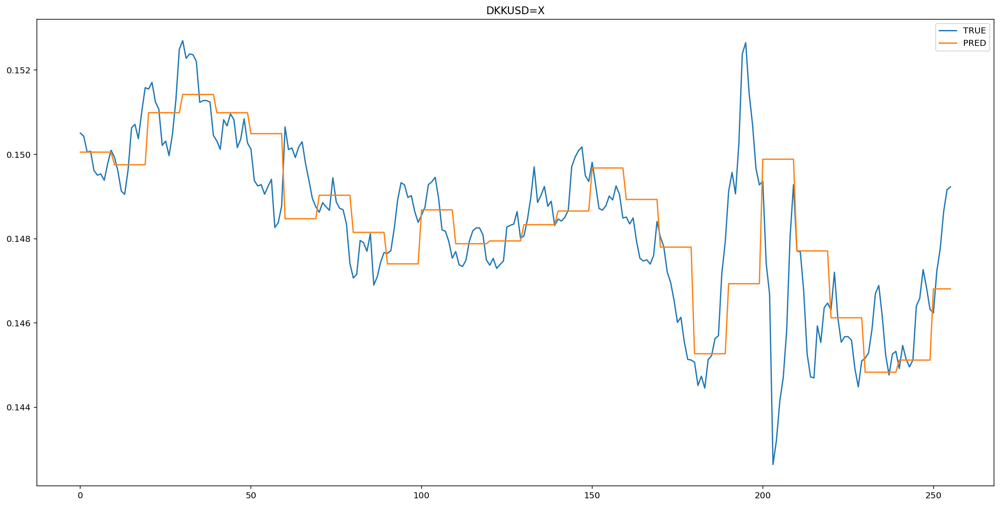

...

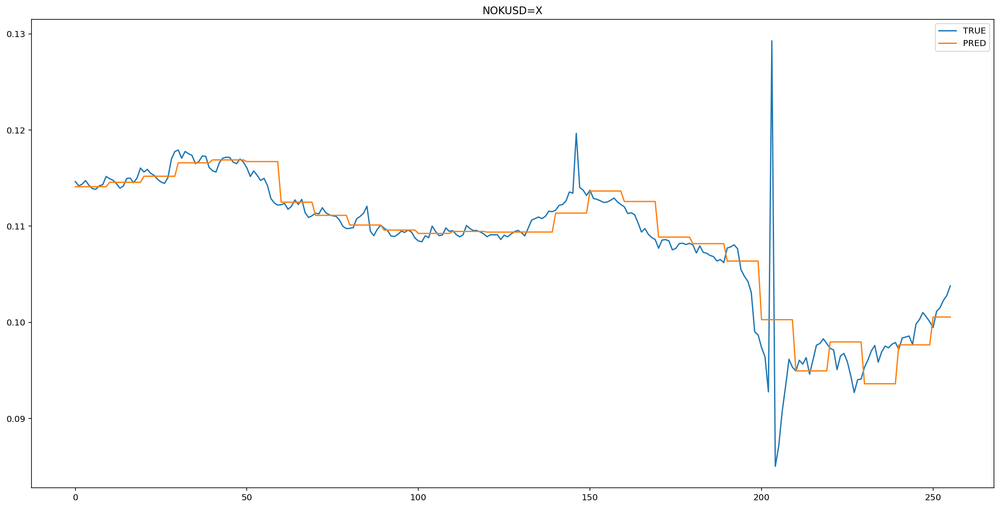

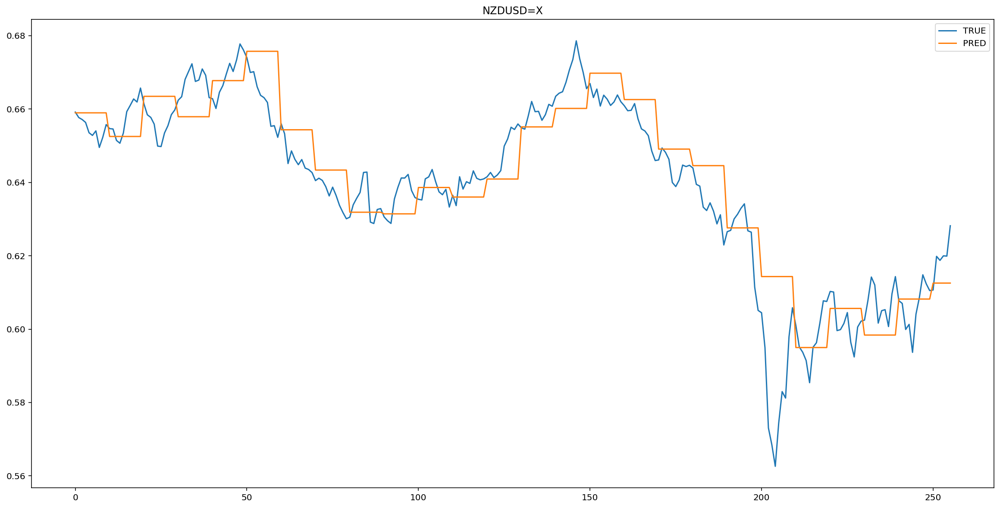

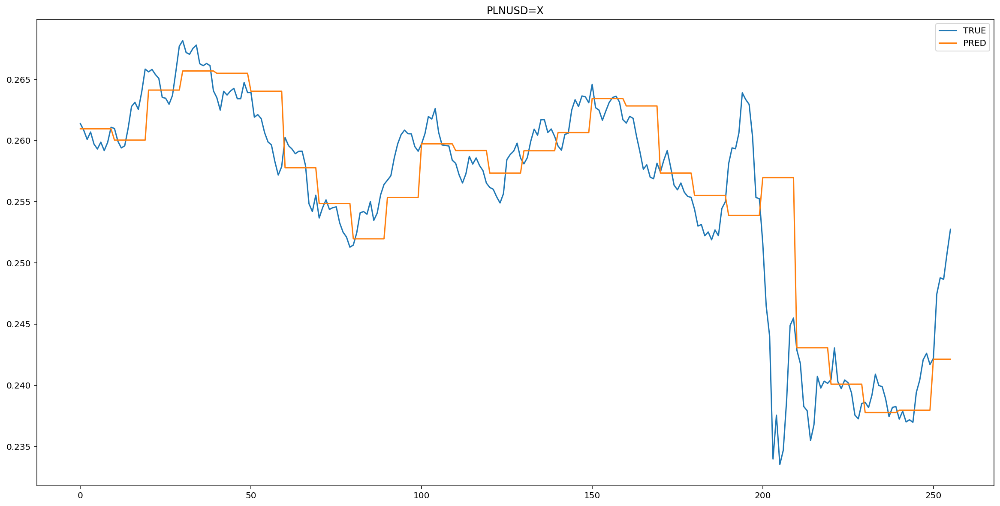

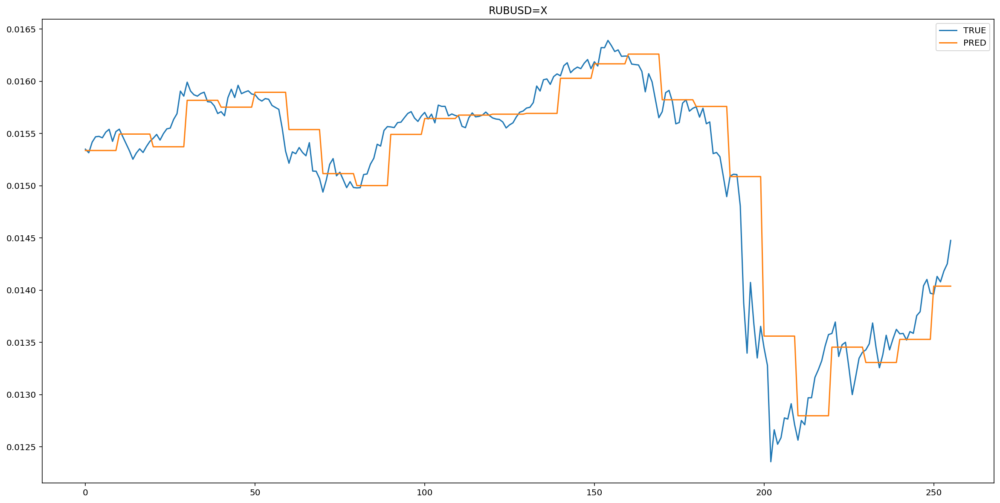

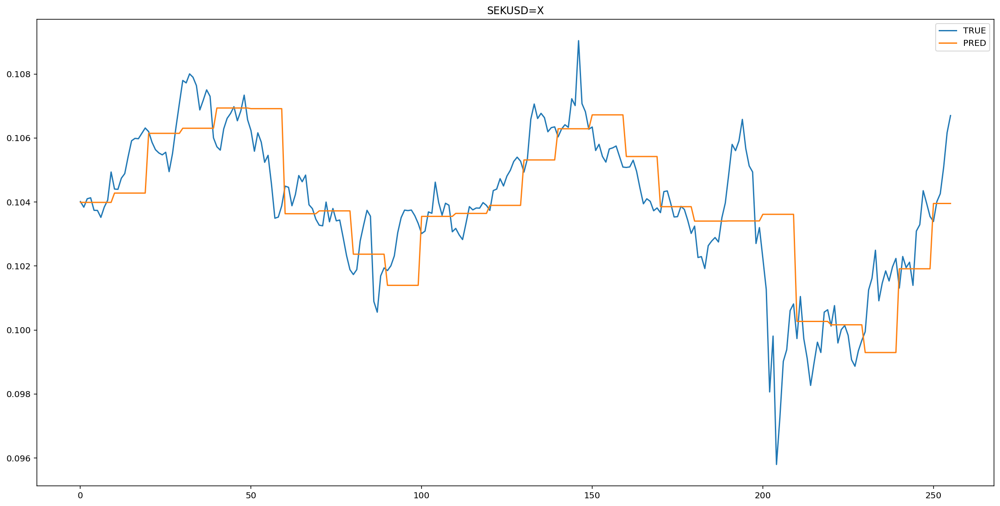

In [34]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [35]:
table.loc['mean'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [36]:
MSE(y_hat, y_pred)

7.106539e-05

In [37]:
RMSE(y_hat, y_pred)

0.008430029

In [38]:
MAE(y_hat, y_pred)

0.0038278026

###Скользящее среднее

####Вычисления

Составляем прогноз

In [39]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.concatenate((temp_pred, np.array([temp_pred[-n:].mean(axis = 0)]))) #скользящее среднее
    y_pred.append(temp_pred[-1])
  i = i + n


Делаем обратное преобразование

In [40]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим график

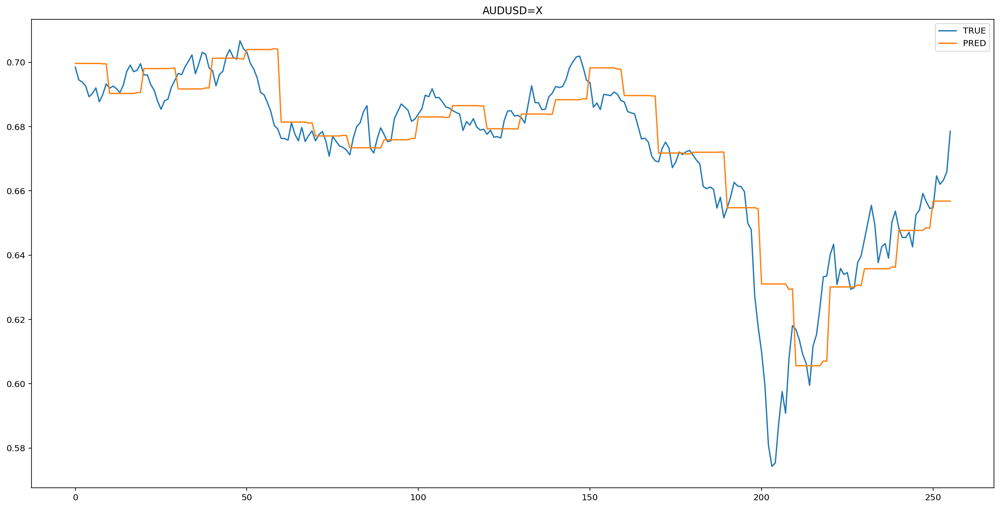

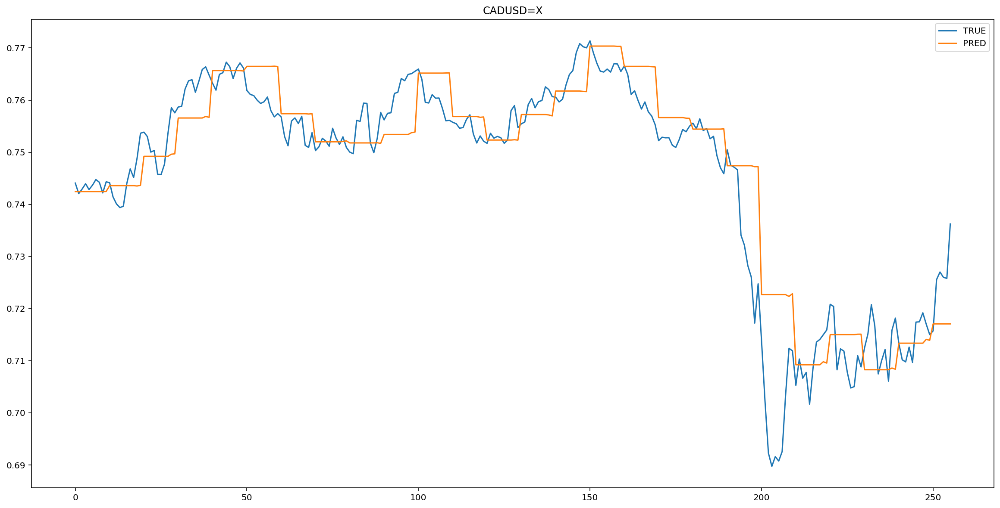

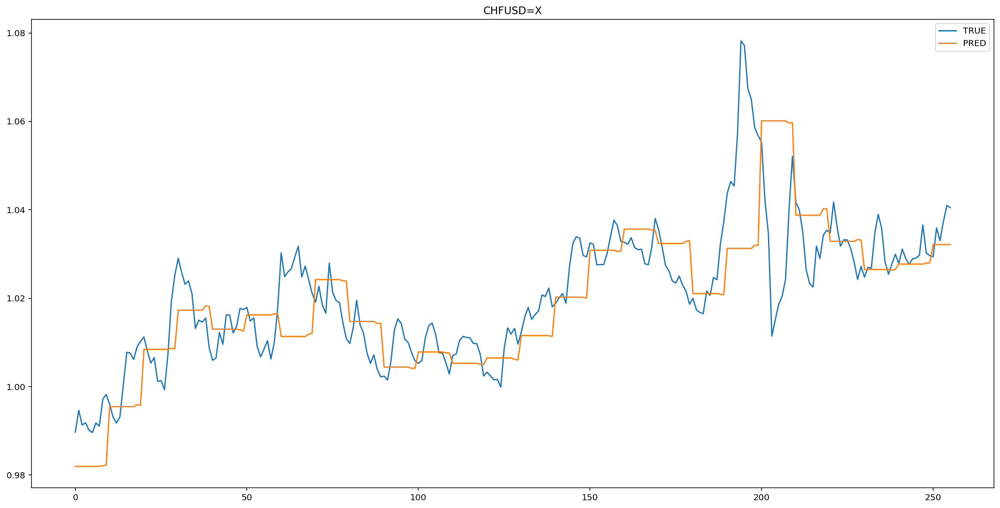

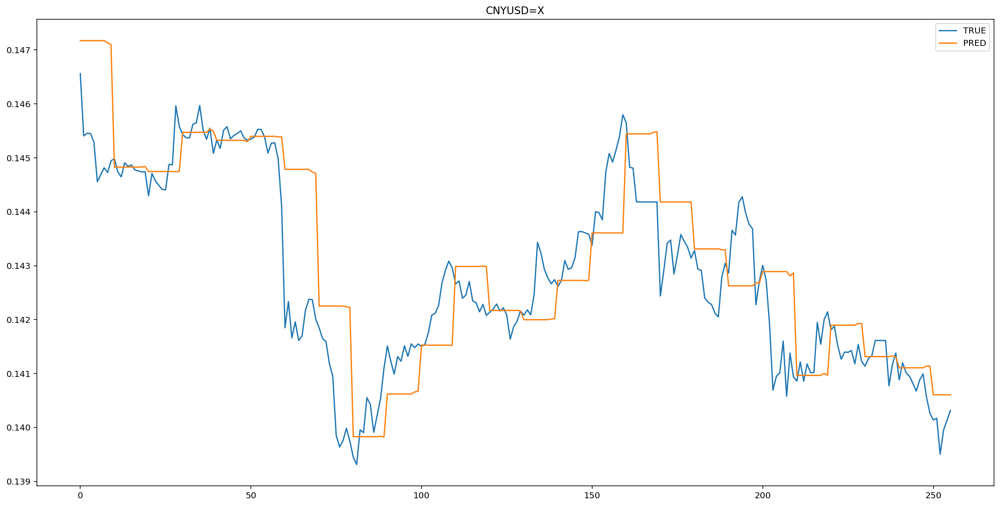

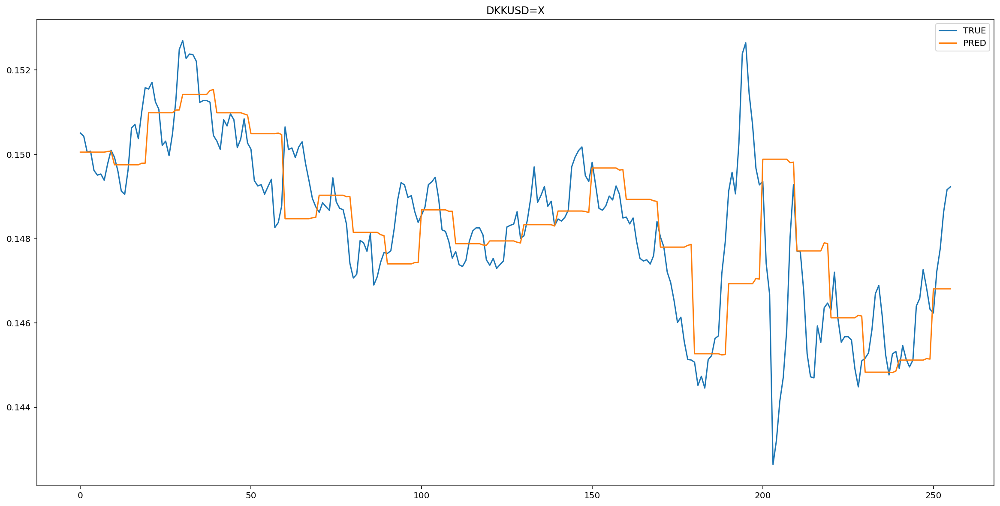

...

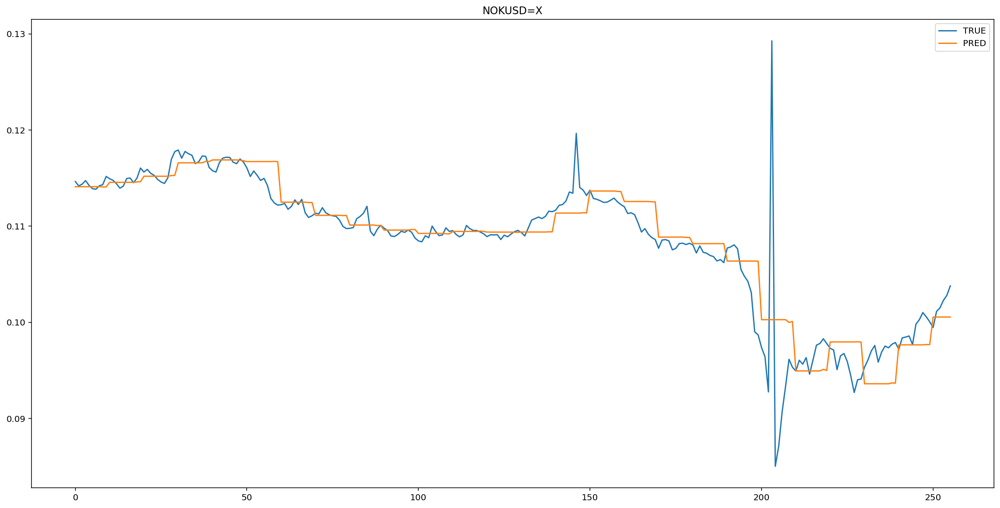

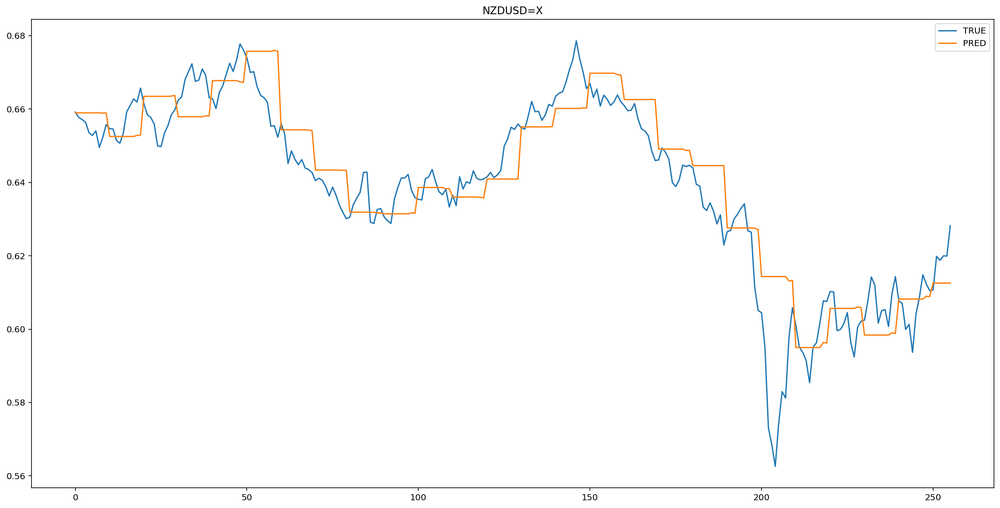

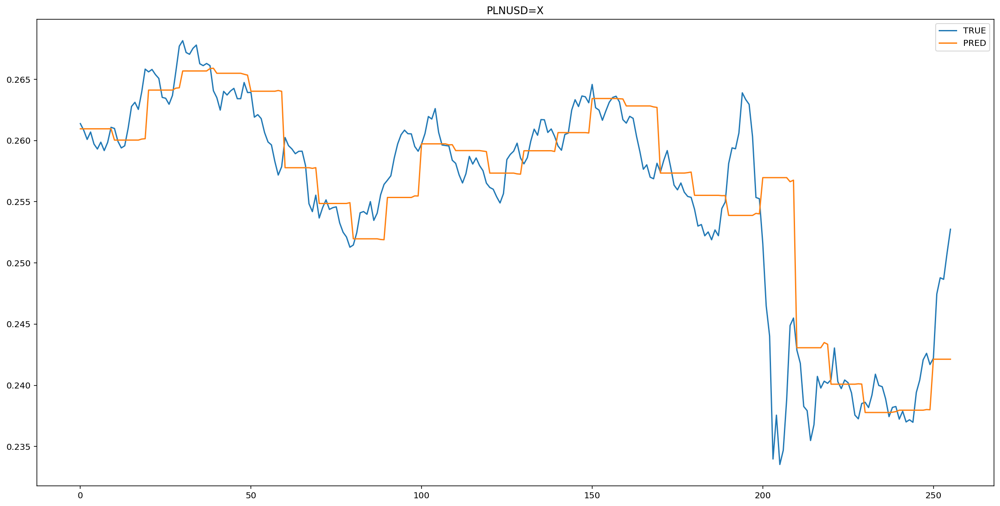

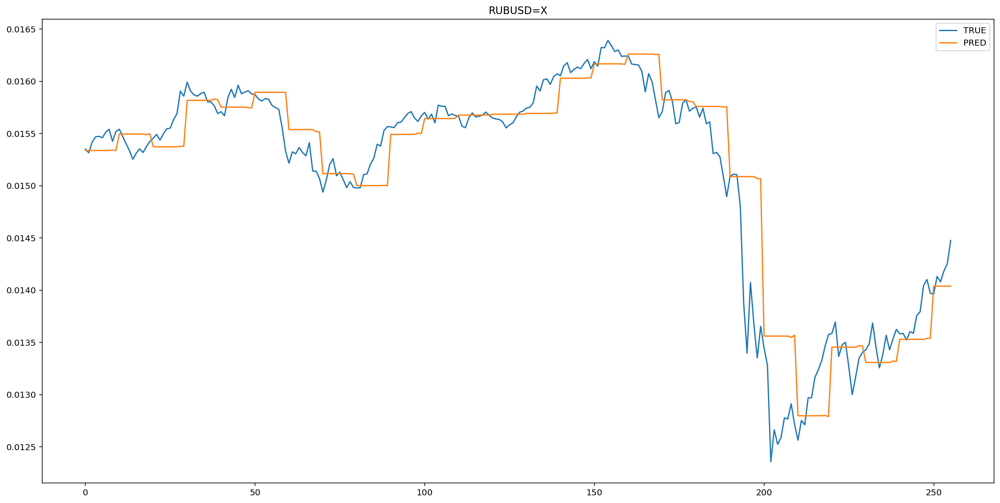

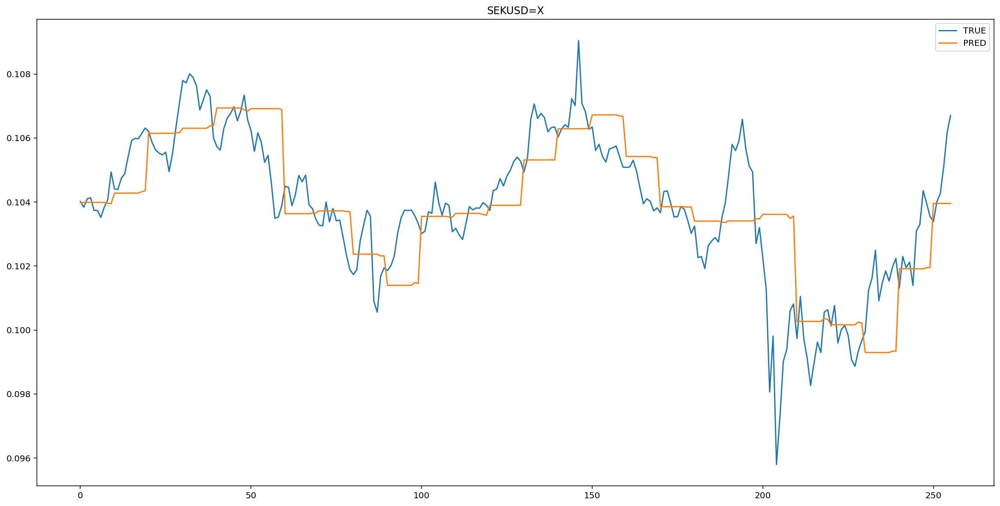

In [41]:
for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [42]:
table.loc['moving average'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [43]:
MSE(y_hat, y_pred)

7.0633825e-05

In [44]:
RMSE(y_hat, y_pred)

0.008404393

In [45]:
MAE(y_hat, y_pred)

0.0038162828

##Регрессия

Импортируем библиотеки

In [46]:
from sklearn.linear_model import Ridge, Lasso

###Простая линейная

Строим модель

In [47]:
linear_model = LinearRegression()
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

Считаем score

In [48]:
 linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9140473018607213

###Lasso

Строим модель

In [49]:
linear_model = Lasso(alpha=0.0001)
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

Lasso(alpha=0.0001, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)

Считаем score

In [50]:
linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9455366477565754

###Ridge

Строим модель

In [51]:
linear_model = Ridge(alpha=0.004)
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

Ridge(alpha=0.004, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001)

Считаем score

In [52]:
linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9190165073227986

##ARIMA

###ARIMA

###SARIMAX

###VAR

####Вычисления

In [53]:
from statsmodels.tsa.api import VAR 

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [54]:
model = VAR(train_y)

In [55]:
results = model.fit(ic='aic') 

In [56]:
y_pred = []

for i in range(len(test_X)):
  y_pred.append(results.forecast(test_X[i], 1)[0])
y_pred = scaler.inverse_transform(np.array(y_pred))
y_hat = scaler.inverse_transform(test_y)

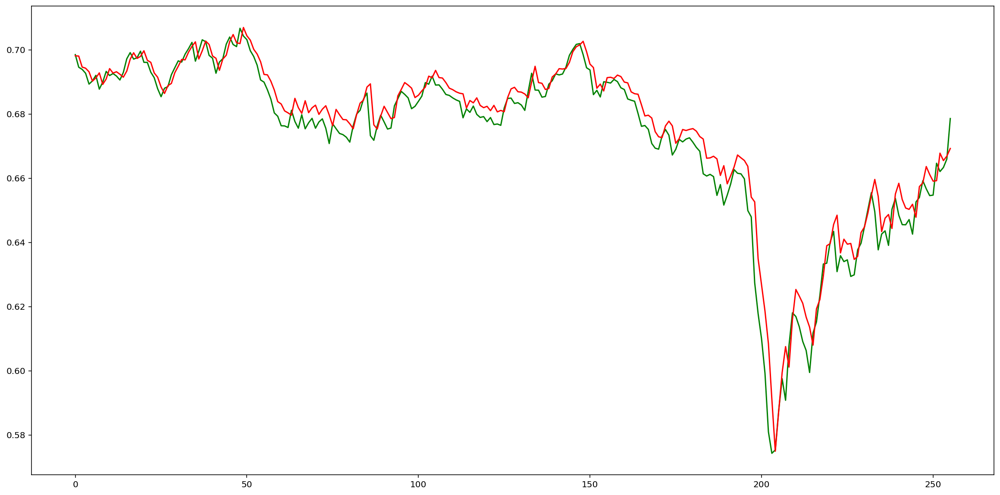

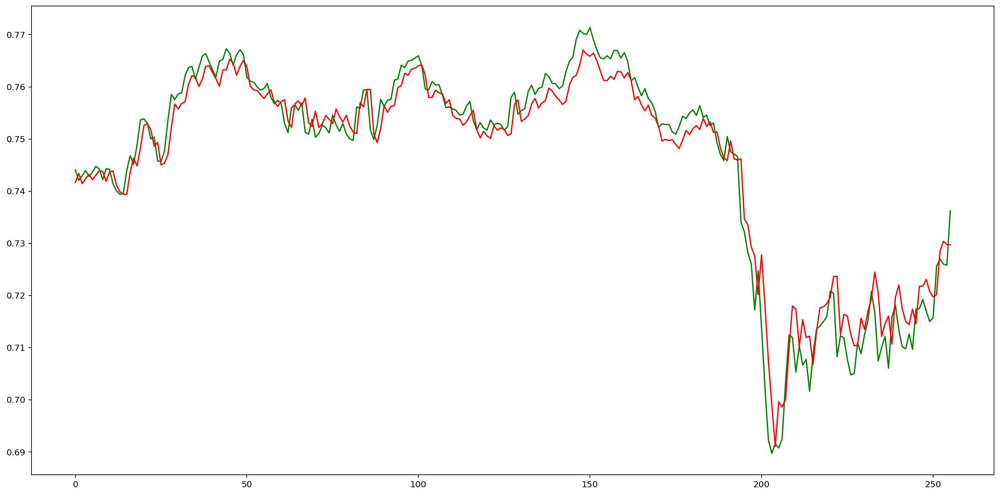

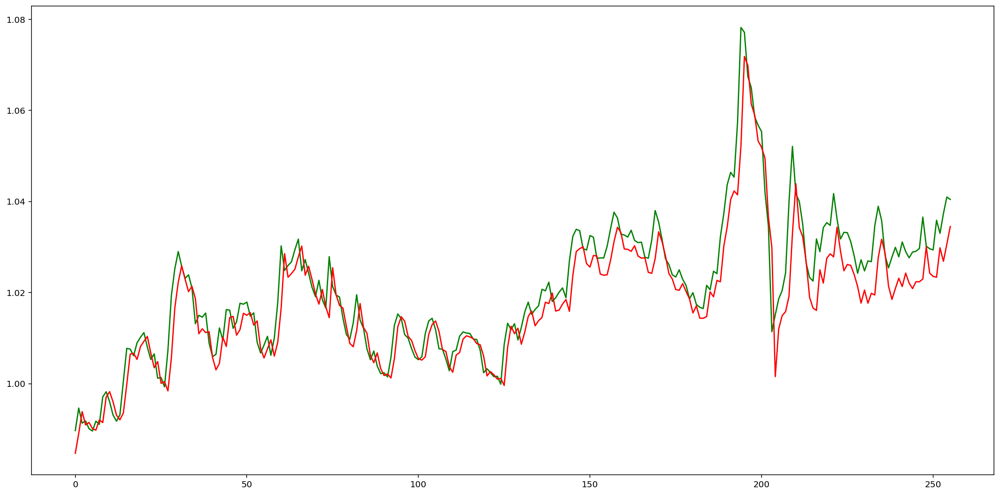

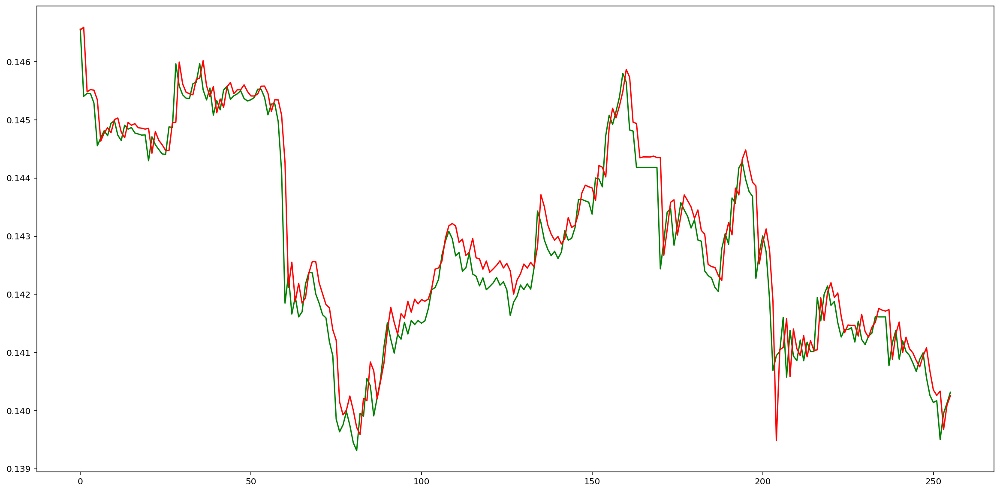

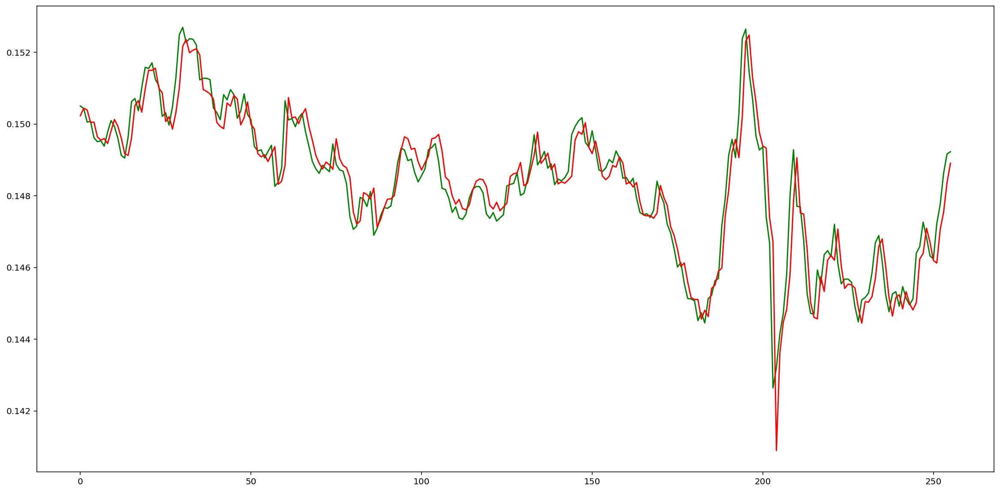

...

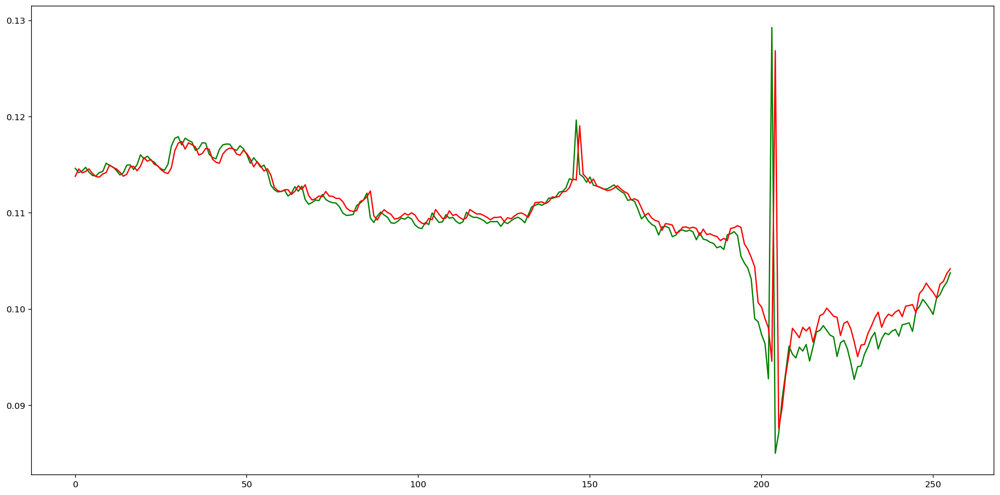

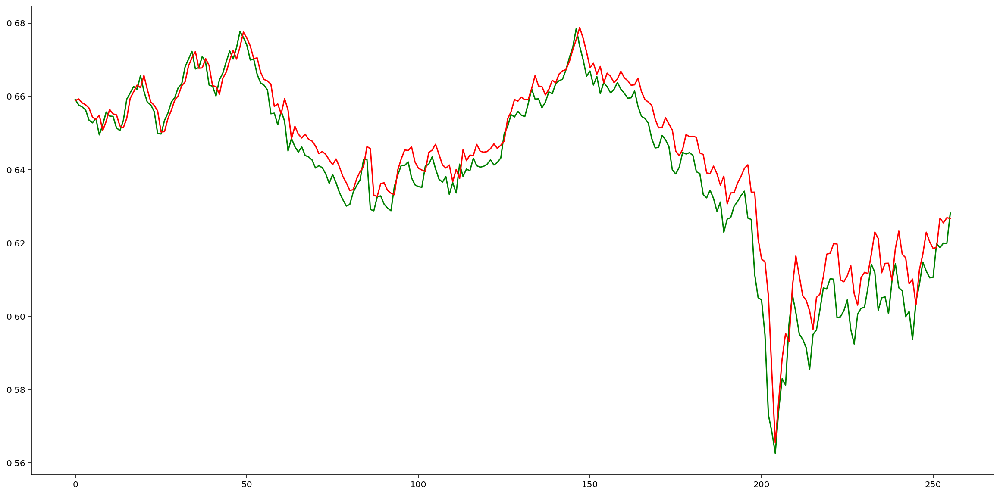

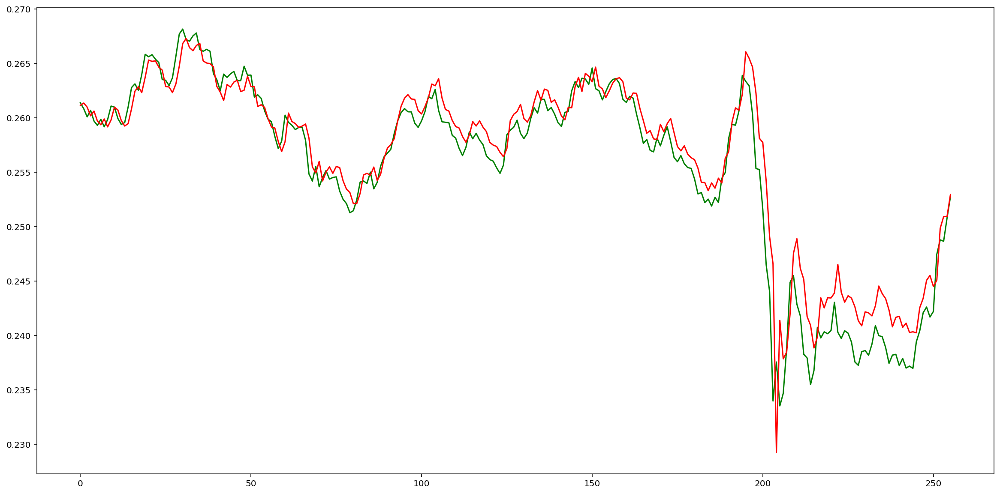

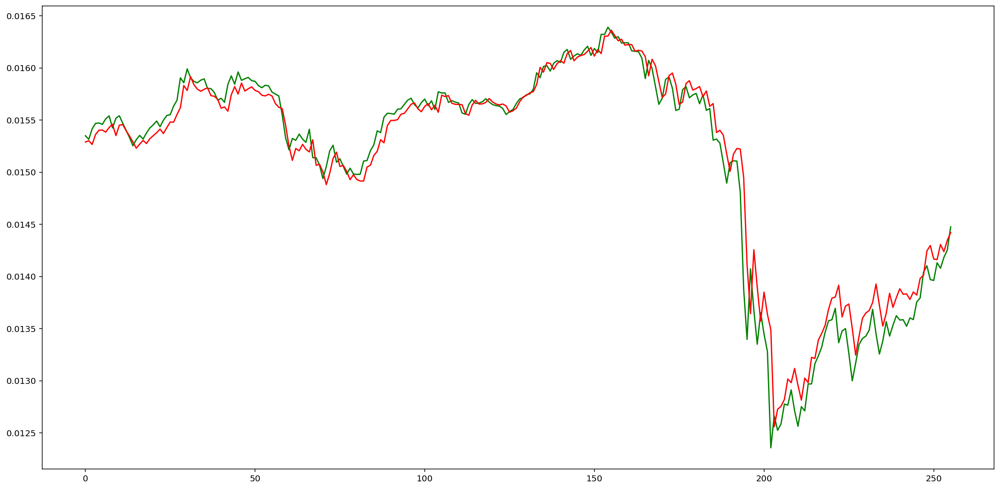

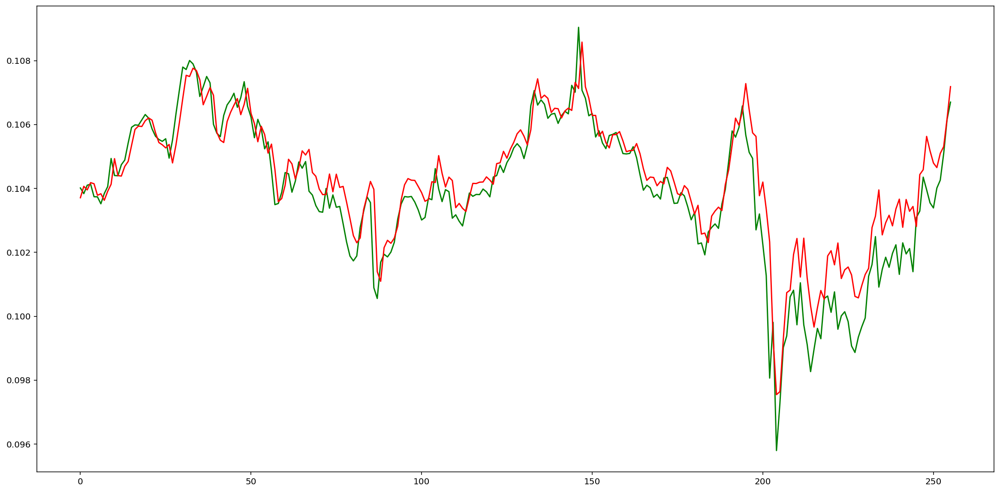

In [57]:
for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.plot(y_hat[:, i], color='green')
    plt.plot(y_pred[:, i], color='red')

####Оцениваем точность

In [58]:
table.loc['VAR'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [59]:
MSE(y_hat, y_pred)

2.1993701887944522e-05

In [60]:
RMSE(y_hat, y_pred)

0.00468974433076522

In [61]:
MAE(y_hat, y_pred)

0.0022954843817325618

###VARIMAX

####Оцениваем точность

In [62]:
MSE(y_hat, y_pred)

2.1993701887944522e-05

In [63]:
RMSE(y_hat, y_pred)

0.00468974433076522

In [64]:
MAE(y_hat, y_pred)

0.0022954843817325618

##Нейронные сети

###Перцептрон

####Вычисления

In [65]:
 # design network
model = Sequential()
model.add(Dense(128, input_shape=(train_X.shape[1], train_X.shape[2]), activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Flatten())
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 1s - loss: 0.3487 - val_loss: 0.0836
Epoch 2/100
5/5 - 0s - loss: 0.1079 - val_loss: 0.0407
Epoch 3/100
5/5 - 0s - loss: 0.0284 - val_loss: 0.0557
Epoch 4/100
5/5 - 0s - loss: 0.0385 - val_loss: 0.0504
Epoch 5/100
5/5 - 0s - loss: 0.0219 - val_loss: 0.0411
Epoch 6/100
5/5 - 0s - loss: 0.0173 - val_loss: 0.0371
Epoch 7/100
5/5 - 0s - loss: 0.0146 - val_loss: 0.0343
Epoch 8/100
5/5 - 0s - loss: 0.0109 - val_loss: 0.0348
Epoch 9/100
5/5 - 0s - loss: 0.0089 - val_loss: 0.0369
Epoch 10/100
5/5 - 0s - loss: 0.0078 - val_loss: 0.0371
Epoch 11/100
5/5 - 0s - loss: 0.0069 - val_loss: 0.0353
Epoch 12/100
5/5 - 0s - loss: 0.0060 - val_loss: 0.0338
Epoch 13/100
5/5 - 0s - loss: 0.0055 - val_loss: 0.0330
Epoch 14/100
5/5 - 0s - loss: 0.0053 - val_loss: 0.0328
Epoch 15/100
5/5 - 0s - loss: 0.0051 - val_loss: 0.0324
Epoch 16/100
5/5 - 0s - loss: 0.0049 - val_loss: 0.0318
Epoch 17/100
5/5 - 0s - loss: 0.0047 - val_loss: 0.0311
Epoch 18/100
5/5 - 0s - loss: 0.0045 - val_loss: 0.0306
E

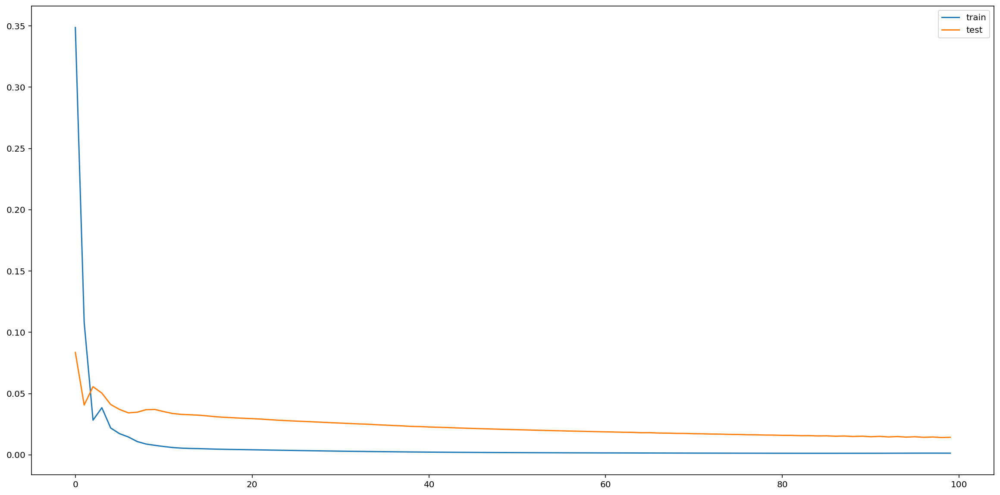

In [66]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
#history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y, epochs=100, batch_size=128, validation_data=(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1), test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [67]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

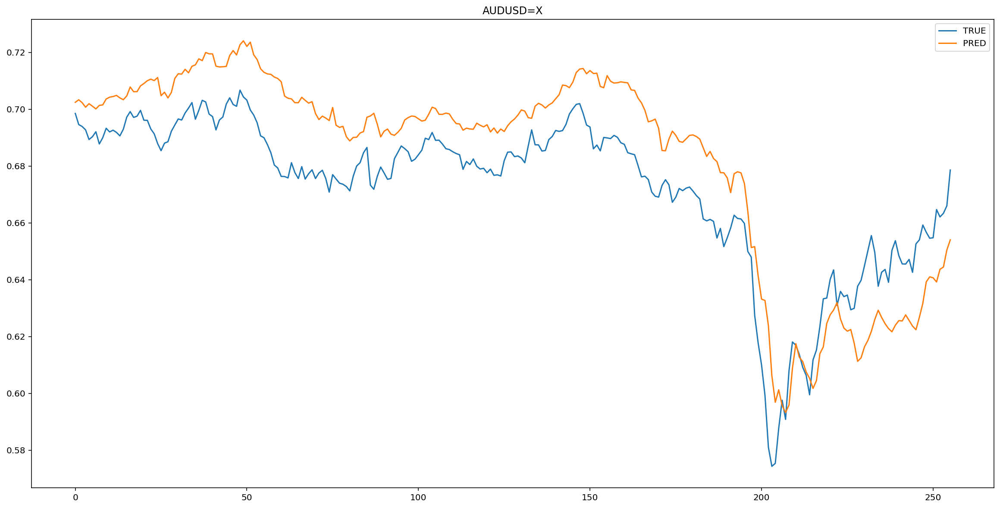

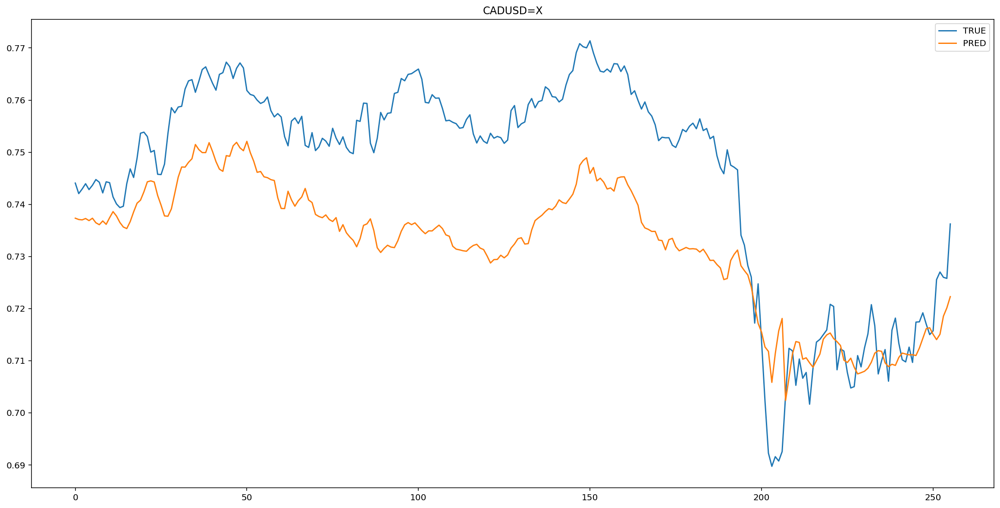

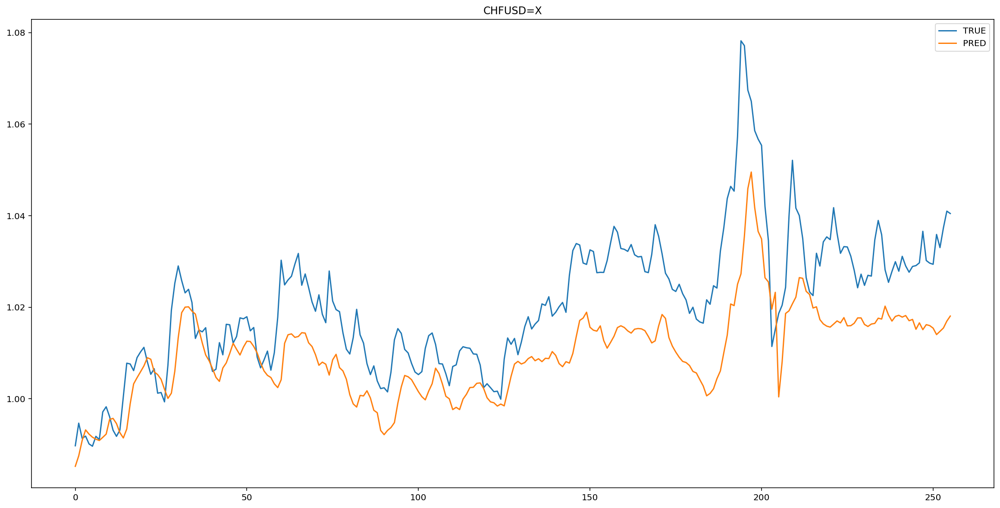

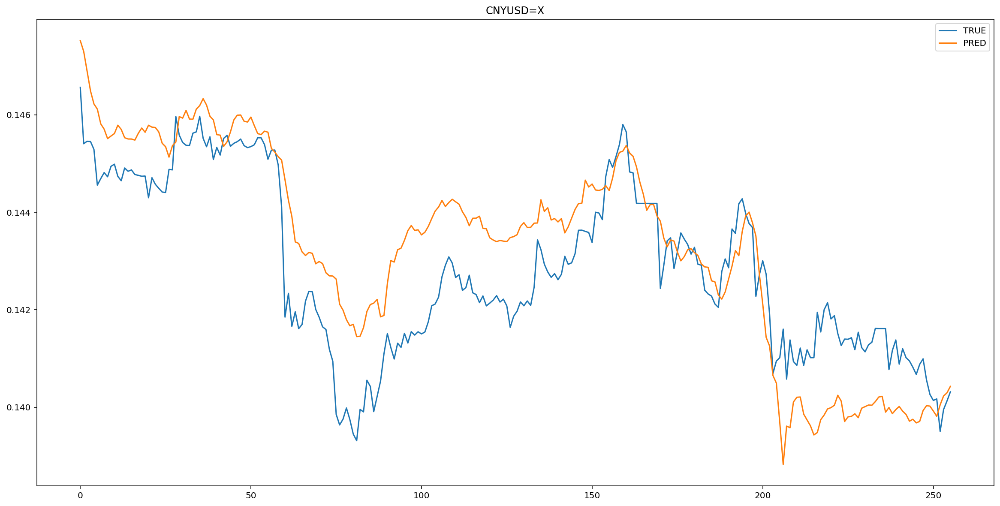

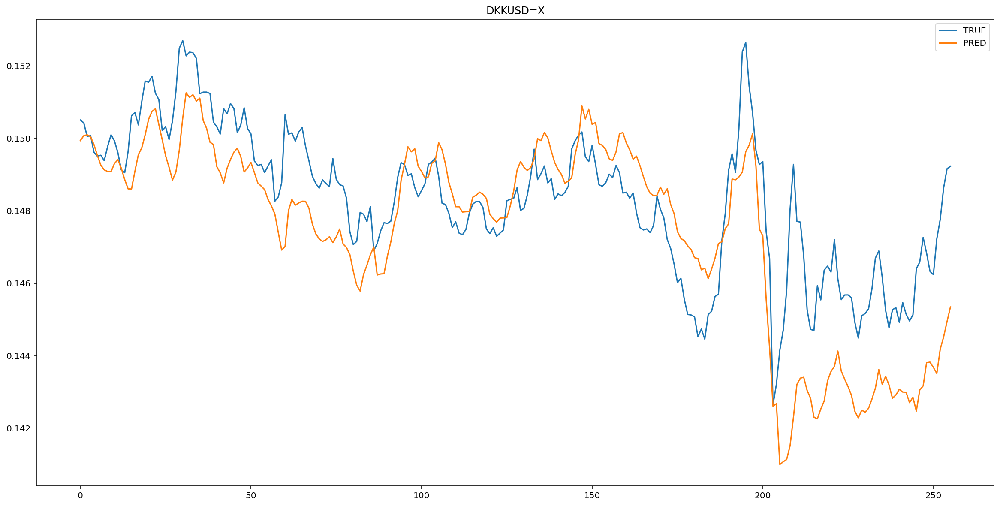

...

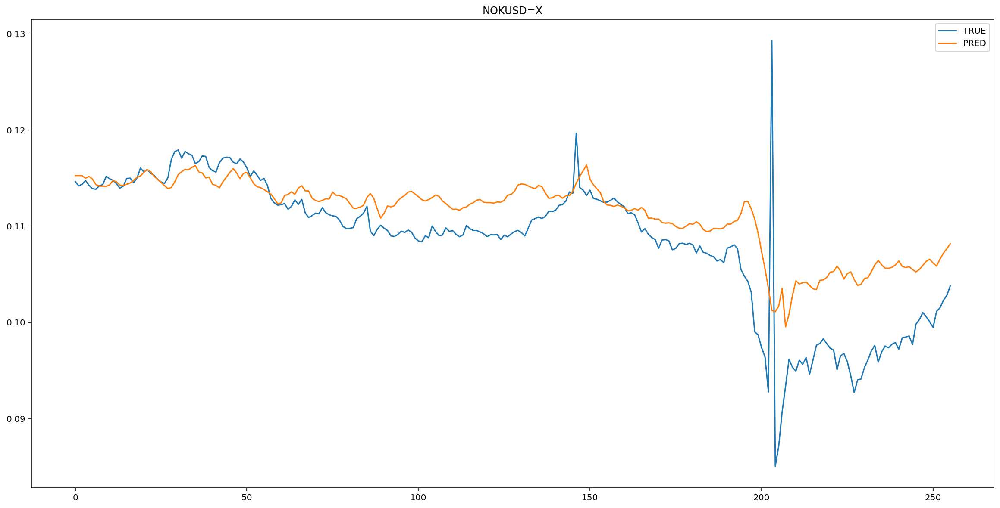

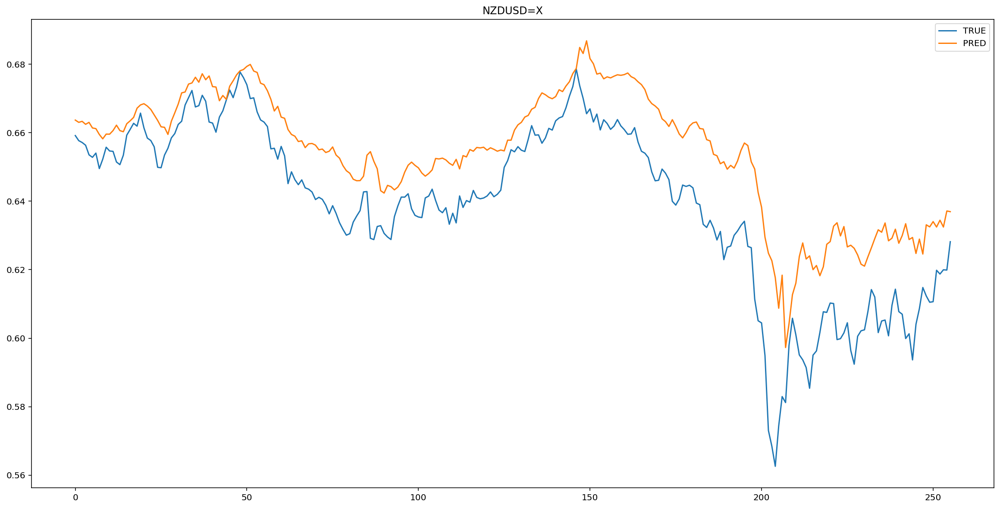

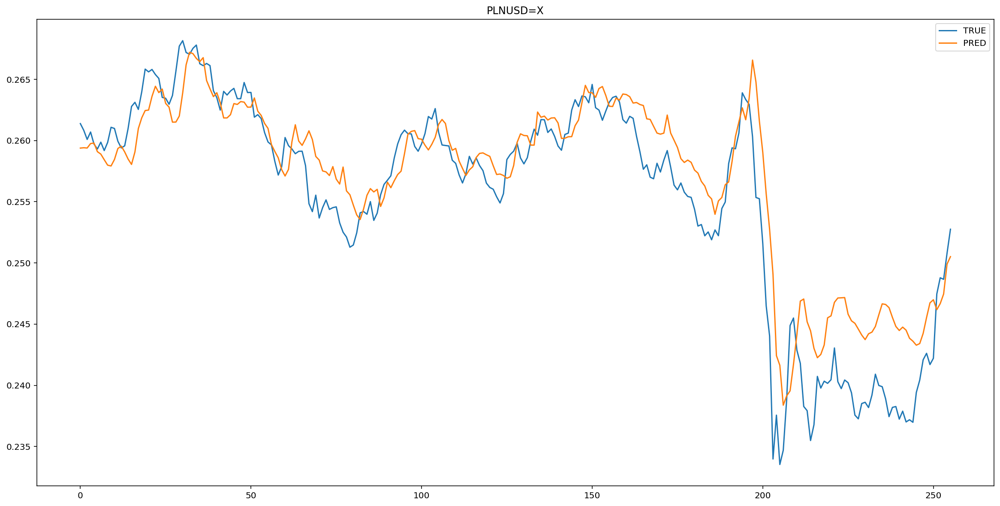

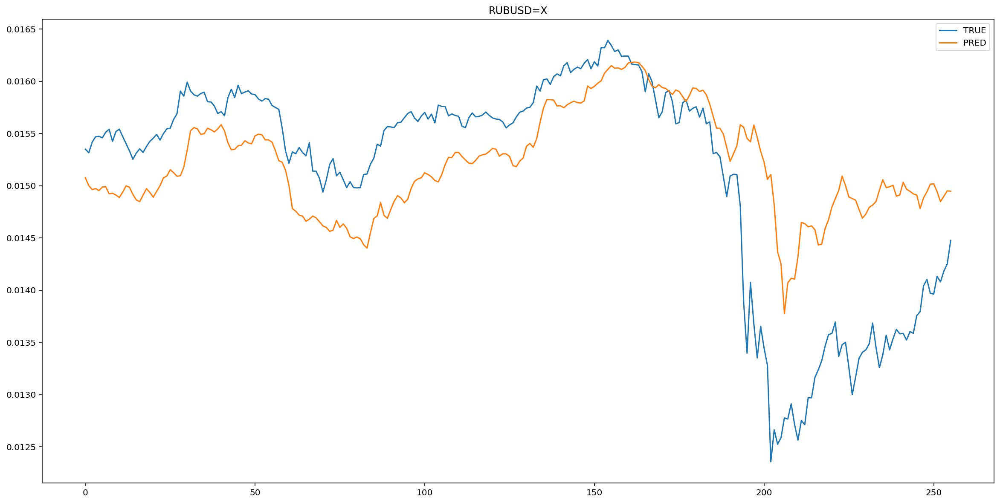

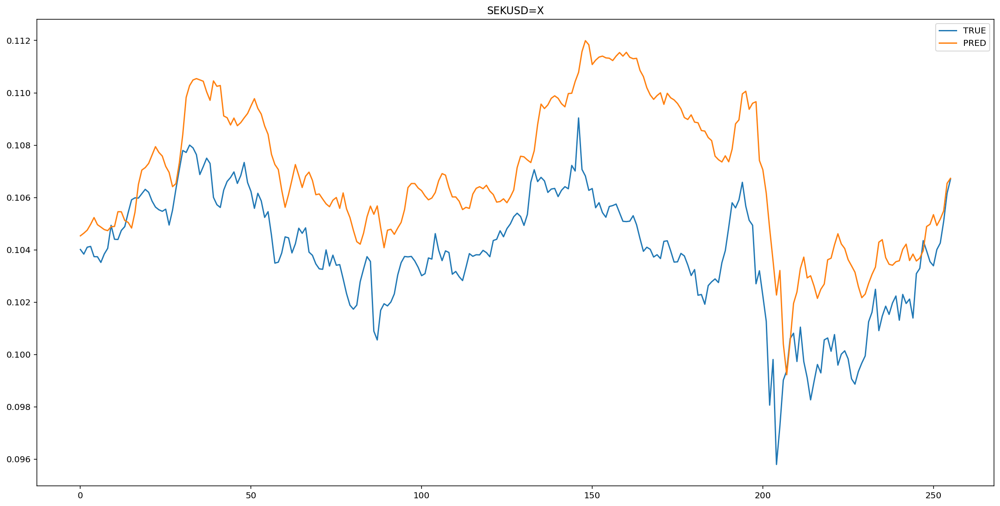

In [68]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [69]:
table.loc['Perc'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [70]:
MSE(y_hat, y_pred)

0.00014292232

In [71]:
RMSE(y_hat, y_pred)

0.011955013

In [72]:
MAE(y_hat, y_pred)

0.007165249

###Свёрточные

####Вычисления

In [73]:
train_X, test_X, valid_X, train_y, test_y, valid_y = split(train_X.shape[2], 1, 0.6, 0.15)

In [74]:
 # design network

model = Sequential()
model.add(Conv2D(128, (8, 8) ,input_shape=(train_X.shape[1], train_X.shape[2], 1), activation='relu'))

model.add(MaxPooling2D(pool_size=(8, 8)))
model.add(Conv2D(32, (1, 1),activation='relu'))
model.add(MaxPooling2D(pool_size=(1, 1)))

model.add(Flatten())

model.add(Dense(64,activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(train_y.shape[1],activation='relu'))

model.compile(loss='mse', optimizer='adam')

In [75]:
 train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1).shape

(603, 15, 15, 1)

Epoch 1/100
4/4 - 2s - loss: 0.3336 - val_loss: 0.1071
Epoch 2/100
4/4 - 0s - loss: 0.2152 - val_loss: 0.0715
Epoch 3/100
4/4 - 0s - loss: 0.2087 - val_loss: 0.0527
Epoch 4/100
4/4 - 0s - loss: 0.1771 - val_loss: 0.0517
Epoch 5/100
4/4 - 0s - loss: 0.1600 - val_loss: 0.0461
Epoch 6/100
4/4 - 0s - loss: 0.1496 - val_loss: 0.0323
Epoch 7/100
4/4 - 0s - loss: 0.1333 - val_loss: 0.0242
Epoch 8/100
4/4 - 0s - loss: 0.1313 - val_loss: 0.0227
Epoch 9/100
4/4 - 0s - loss: 0.1200 - val_loss: 0.0248
Epoch 10/100
4/4 - 0s - loss: 0.1134 - val_loss: 0.0206
Epoch 11/100
4/4 - 0s - loss: 0.1076 - val_loss: 0.0157
Epoch 12/100
4/4 - 0s - loss: 0.0988 - val_loss: 0.0147
Epoch 13/100
4/4 - 0s - loss: 0.0979 - val_loss: 0.0150
Epoch 14/100
4/4 - 0s - loss: 0.0918 - val_loss: 0.0133
Epoch 15/100
4/4 - 0s - loss: 0.0872 - val_loss: 0.0119
Epoch 16/100
4/4 - 0s - loss: 0.0852 - val_loss: 0.0108
Epoch 17/100
4/4 - 0s - loss: 0.0822 - val_loss: 0.0108
Epoch 18/100
4/4 - 0s - loss: 0.0803 - val_loss: 0.0110
E

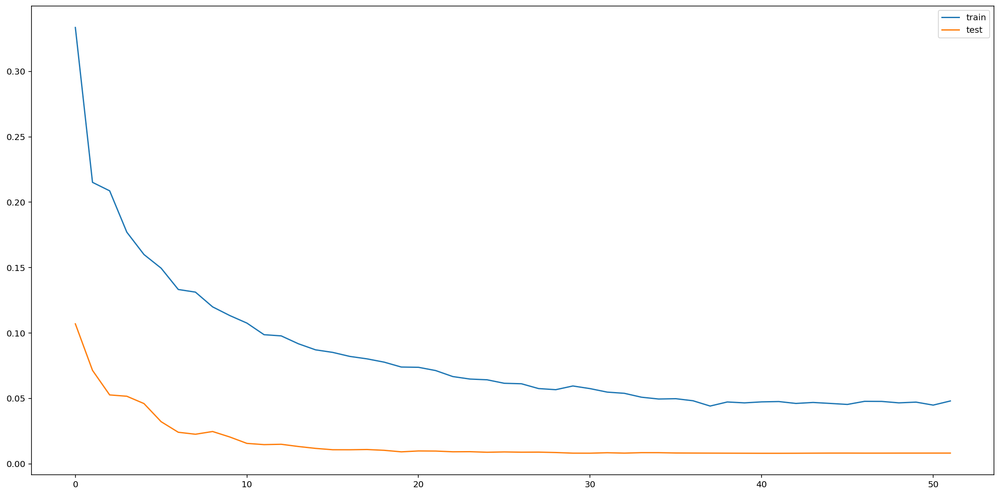

In [76]:
# fit network
#history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
#history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y, epochs=100, batch_size=128, validation_data=(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1), test_y), verbose=2, shuffle=False)

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y,\
                    epochs=100, batch_size=128,validation_split=0.25,\
                    verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [77]:
model.evaluate(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y)

19/19 [==============================] - 0s 3ms/step - loss: 0.0163


0.016340218484401703

In [78]:
y_hat = scaler.inverse_transform(test_y)
#y_pred = scaler.inverse_transform(model.predict(test_X))
y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

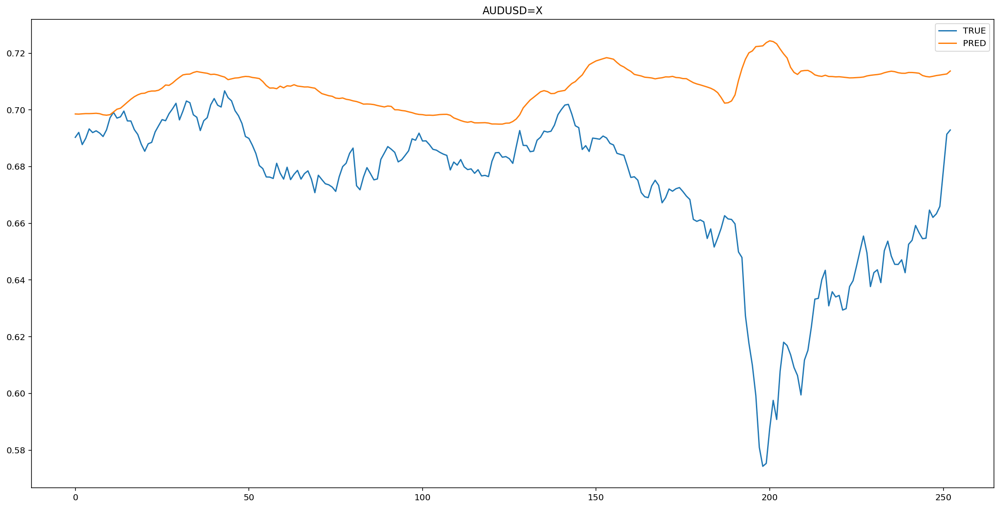

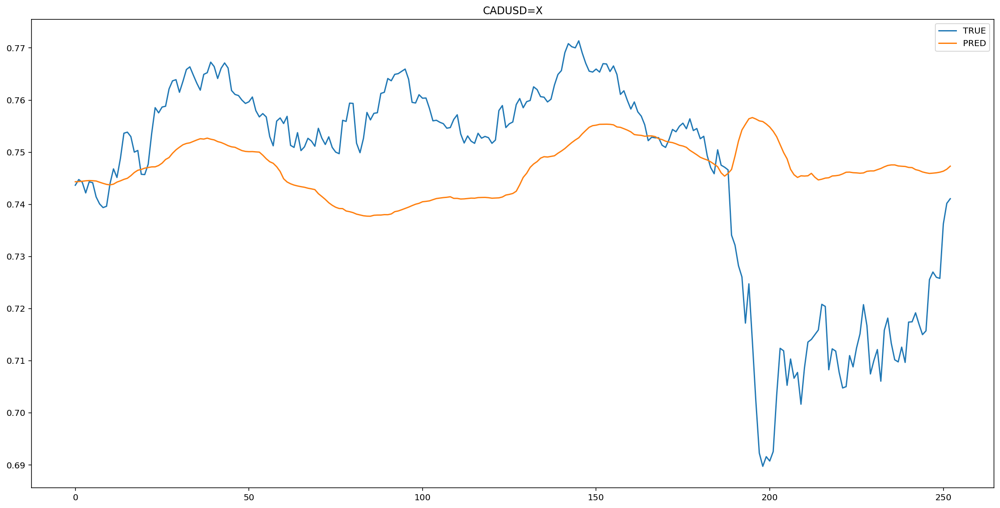

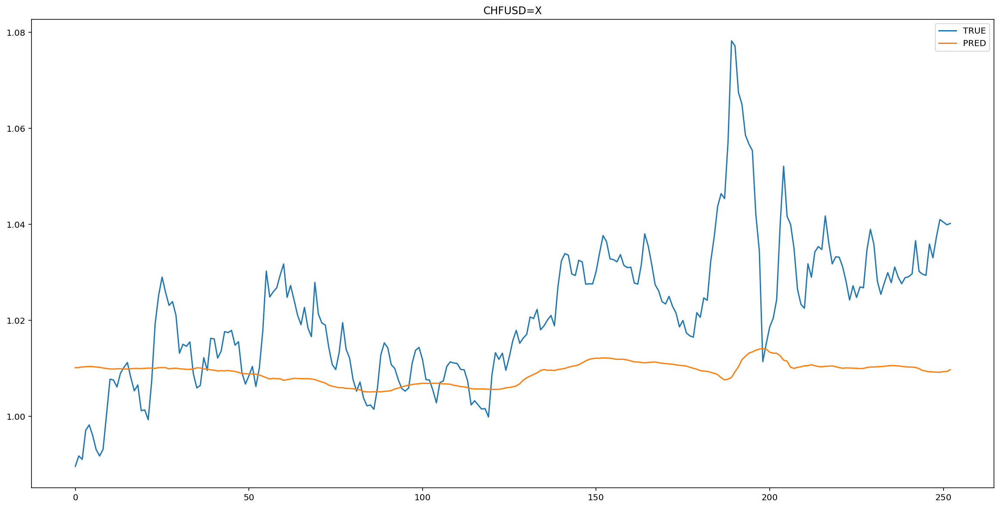

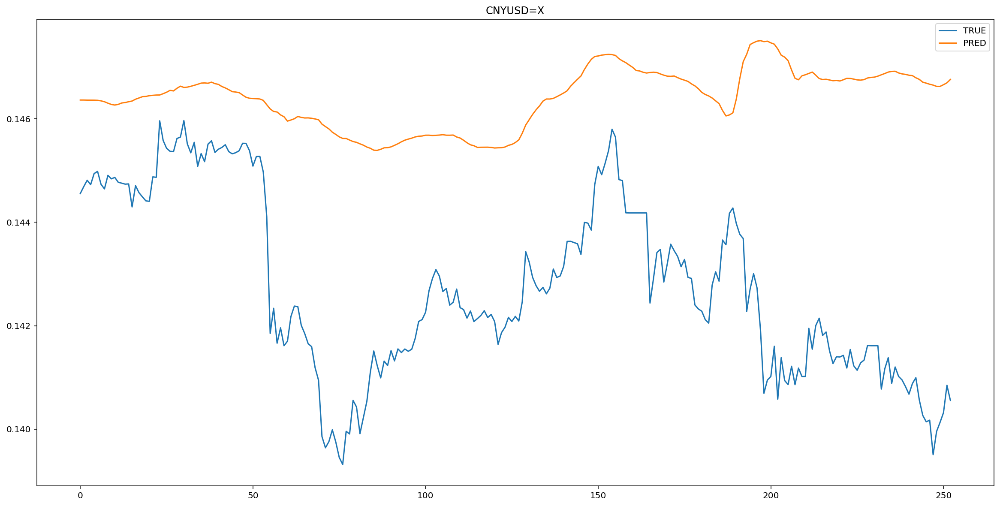

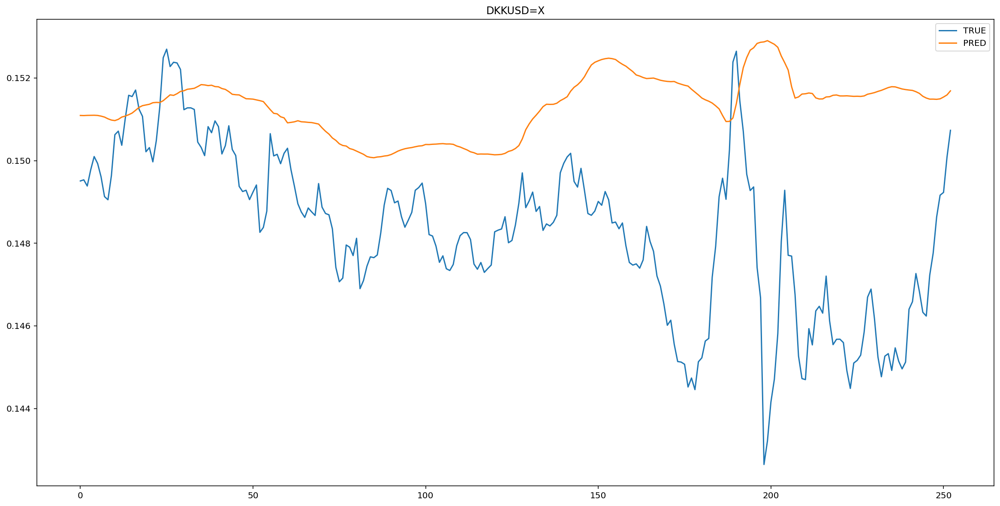

...

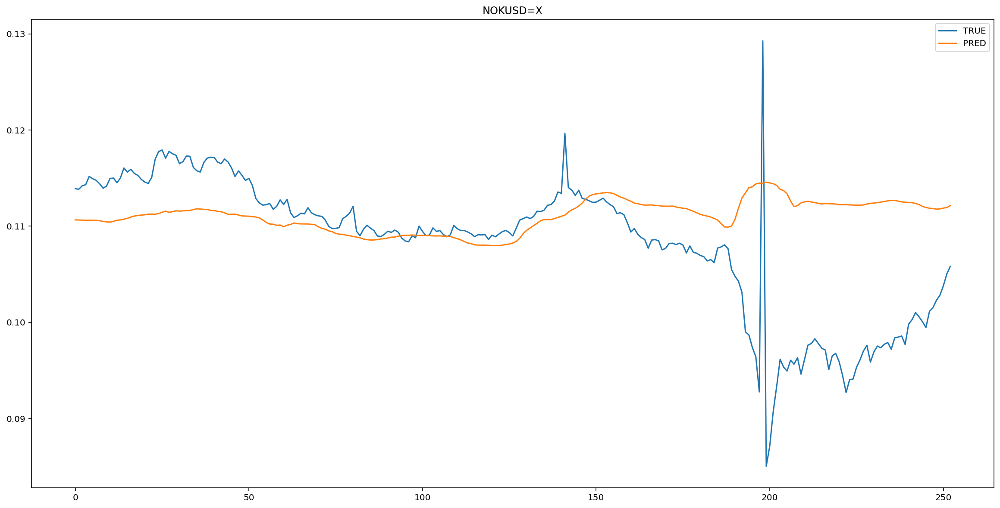

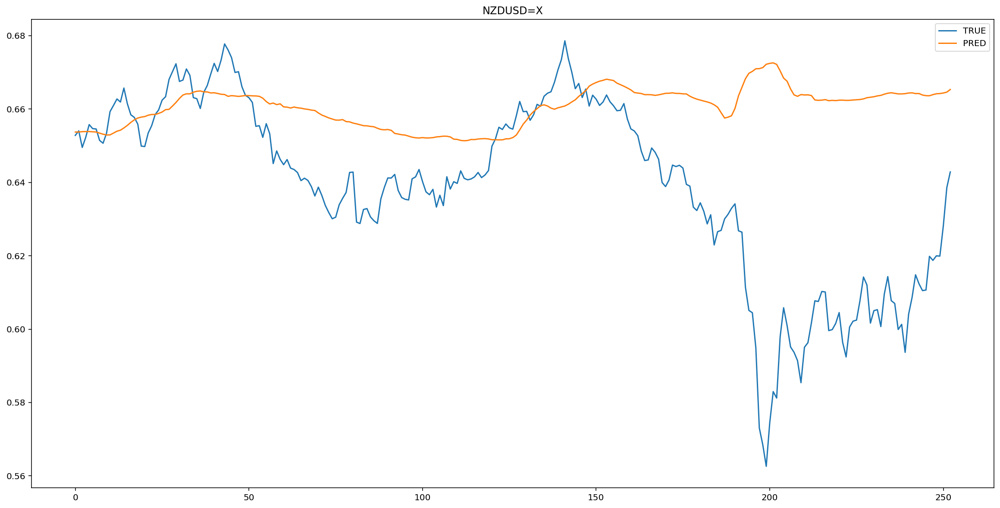

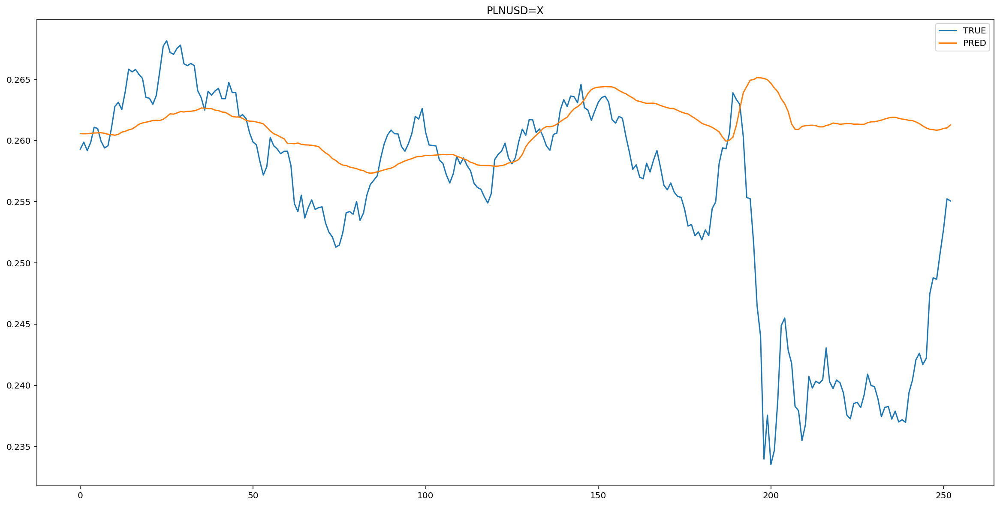

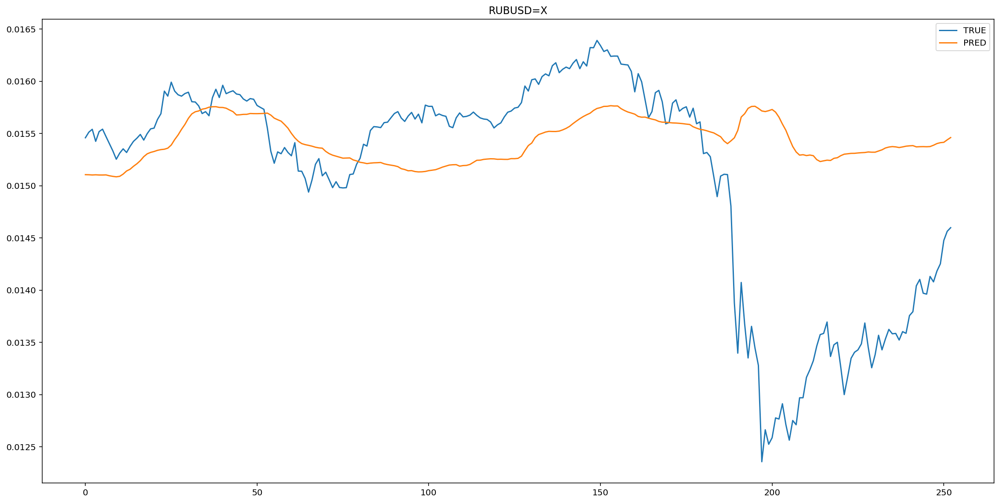

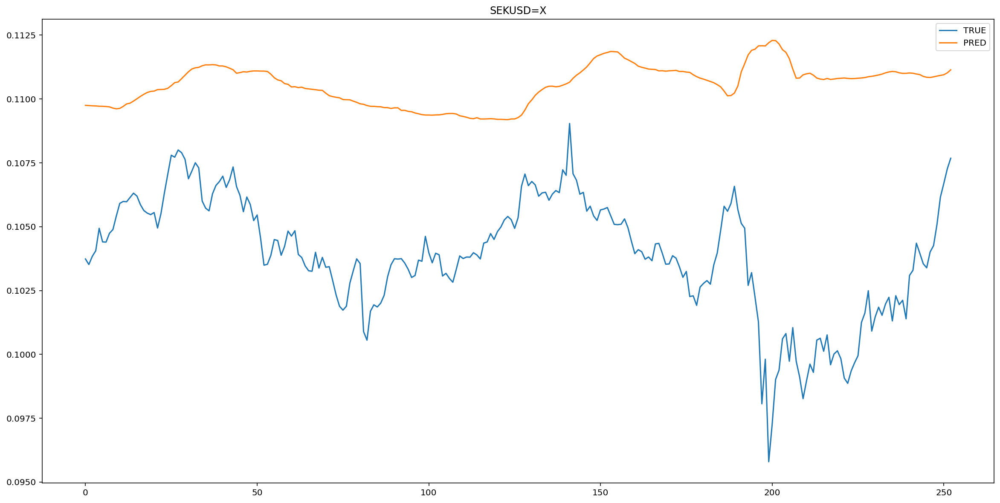

In [79]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [80]:
table.loc['Conv'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [81]:
MSE(y_hat, y_pred)

0.00042743044

In [82]:
RMSE(y_hat, y_pred)

0.02067439

In [83]:
MAE(y_hat, y_pred)

0.011099048

###Рекуррентные

In [84]:
train_X, test_X, valid_X, train_y, test_y, valid_y = split(3, 1, 0.6, 0.15)

####RNN

#####Вычисления

In [85]:
# design network
model = Sequential()
model.add(SimpleRNN(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(SimpleRNN(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 1s - loss: 0.3545 - val_loss: 0.0773
Epoch 2/100
5/5 - 0s - loss: 0.0774 - val_loss: 0.0572
Epoch 3/100
5/5 - 0s - loss: 0.0478 - val_loss: 0.0472
Epoch 4/100
5/5 - 0s - loss: 0.0205 - val_loss: 0.0378
Epoch 5/100
5/5 - 0s - loss: 0.0204 - val_loss: 0.0364
Epoch 6/100
5/5 - 0s - loss: 0.0138 - val_loss: 0.0377
Epoch 7/100
5/5 - 0s - loss: 0.0112 - val_loss: 0.0356
Epoch 8/100
5/5 - 0s - loss: 0.0087 - val_loss: 0.0342
Epoch 9/100
5/5 - 0s - loss: 0.0071 - val_loss: 0.0344
Epoch 10/100
5/5 - 0s - loss: 0.0062 - val_loss: 0.0332
Epoch 11/100
5/5 - 0s - loss: 0.0054 - val_loss: 0.0327
Epoch 12/100
5/5 - 0s - loss: 0.0050 - val_loss: 0.0316
Epoch 13/100
5/5 - 0s - loss: 0.0047 - val_loss: 0.0295
Epoch 14/100
5/5 - 0s - loss: 0.0044 - val_loss: 0.0299
Epoch 15/100
5/5 - 0s - loss: 0.0041 - val_loss: 0.0305
Epoch 16/100
5/5 - 0s - loss: 0.0039 - val_loss: 0.0291
Epoch 17/100
5/5 - 0s - loss: 0.0037 - val_loss: 0.0283
Epoch 18/100
5/5 - 0s - loss: 0.0036 - val_loss: 0.0277
E

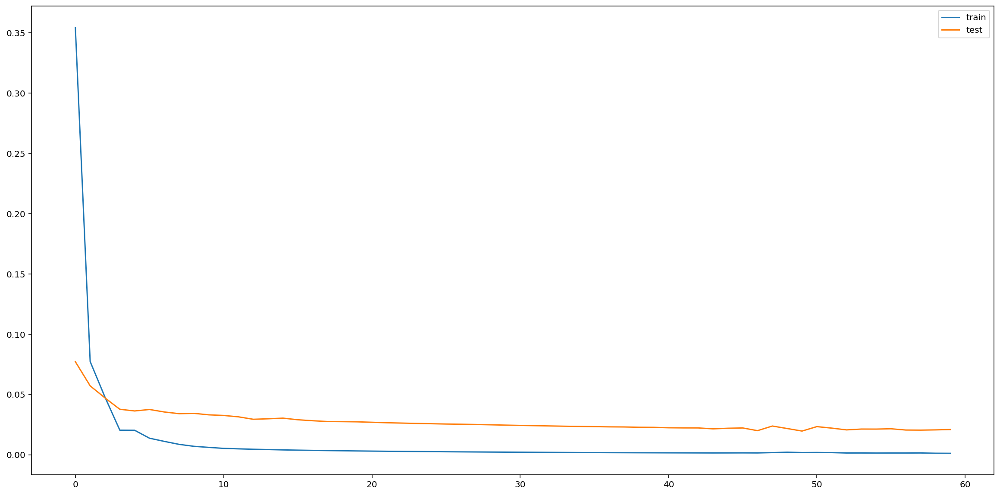

In [86]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [87]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

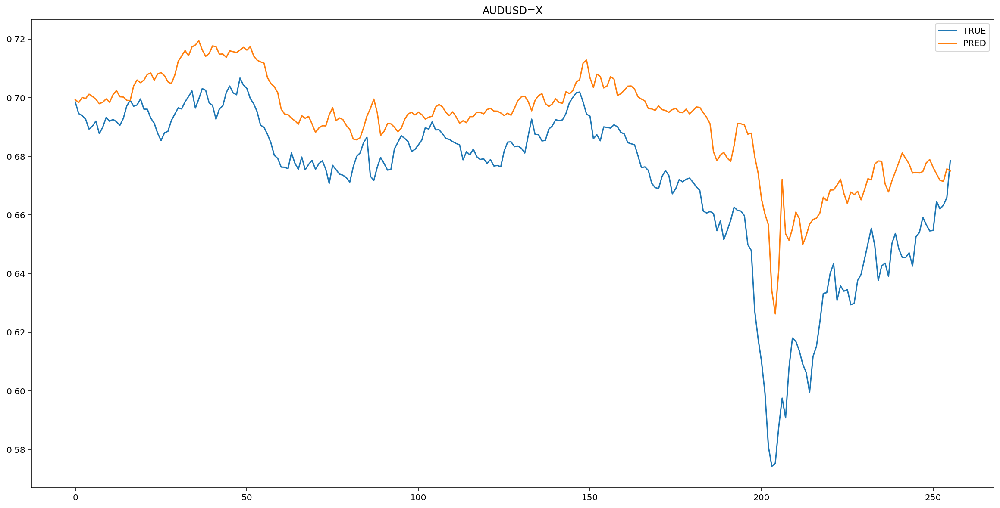

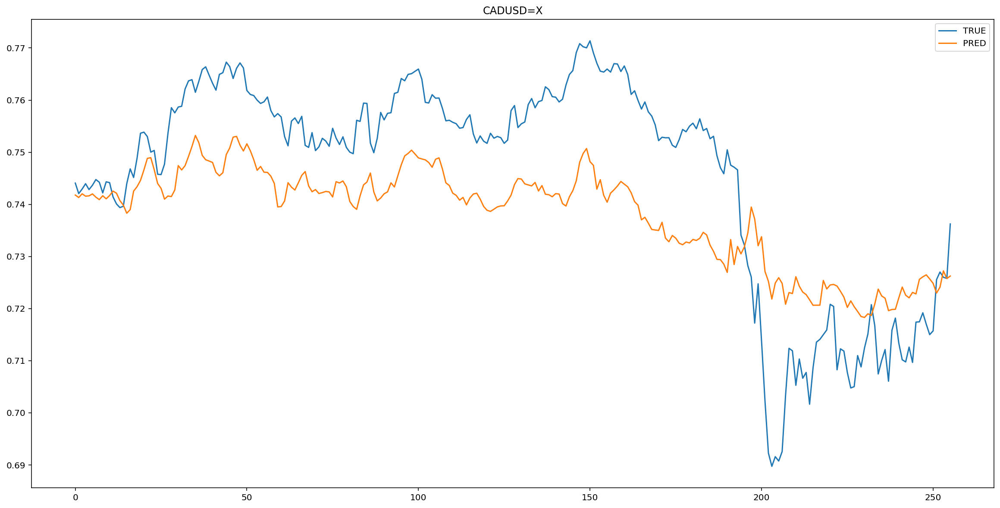

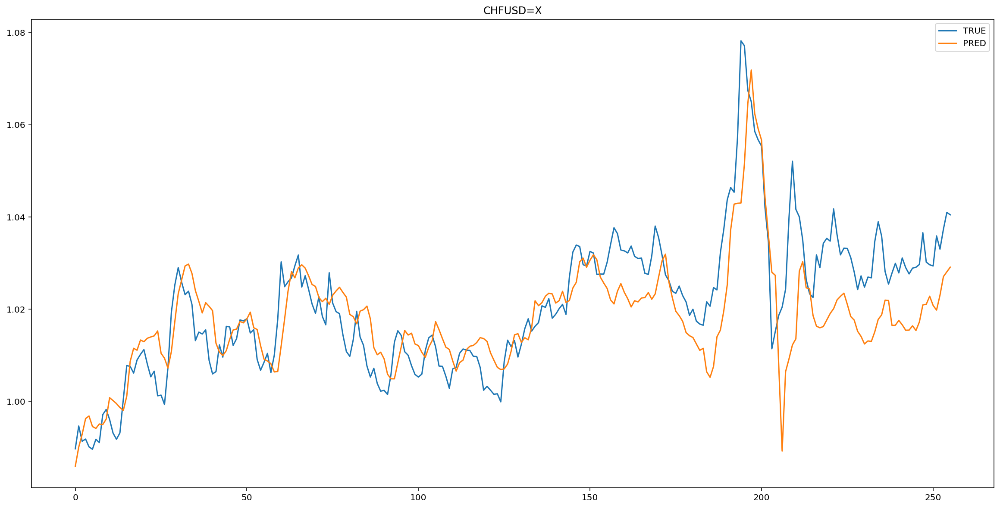

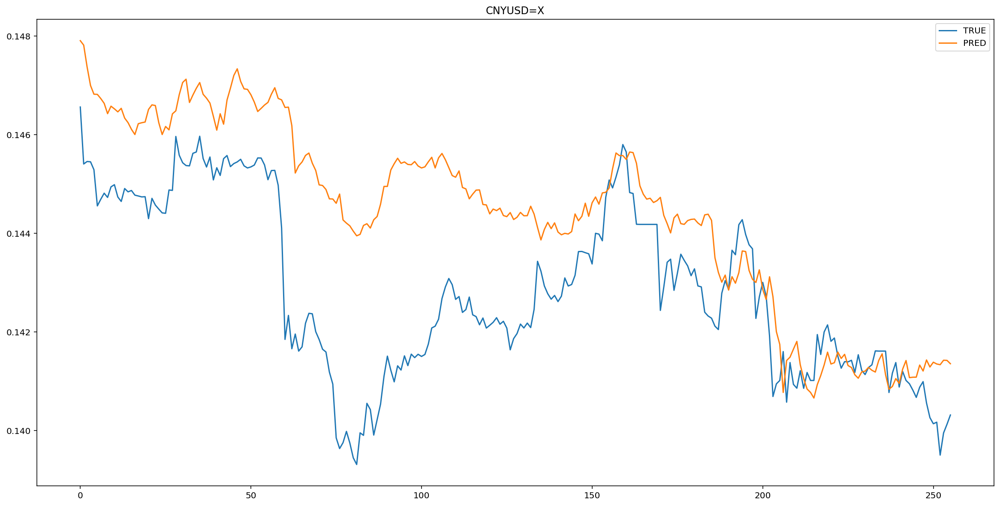

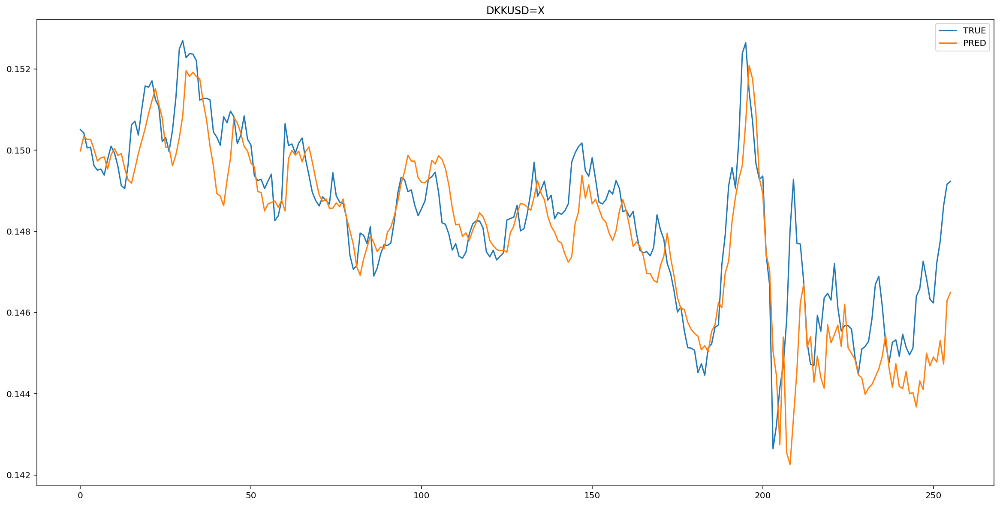

...

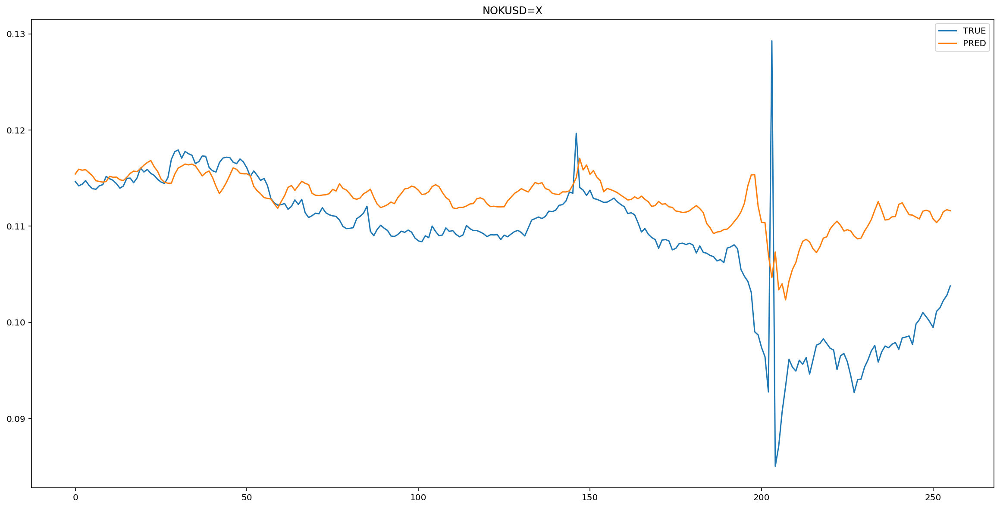

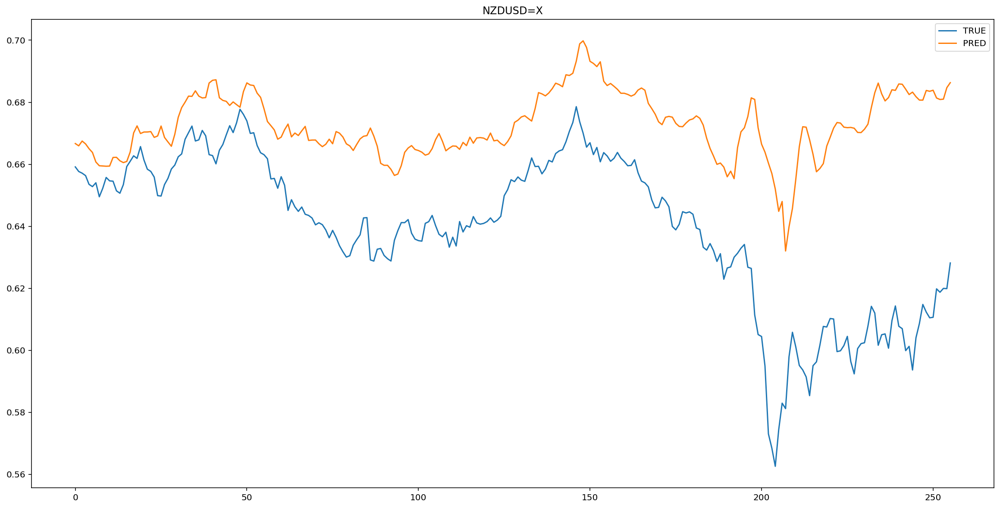

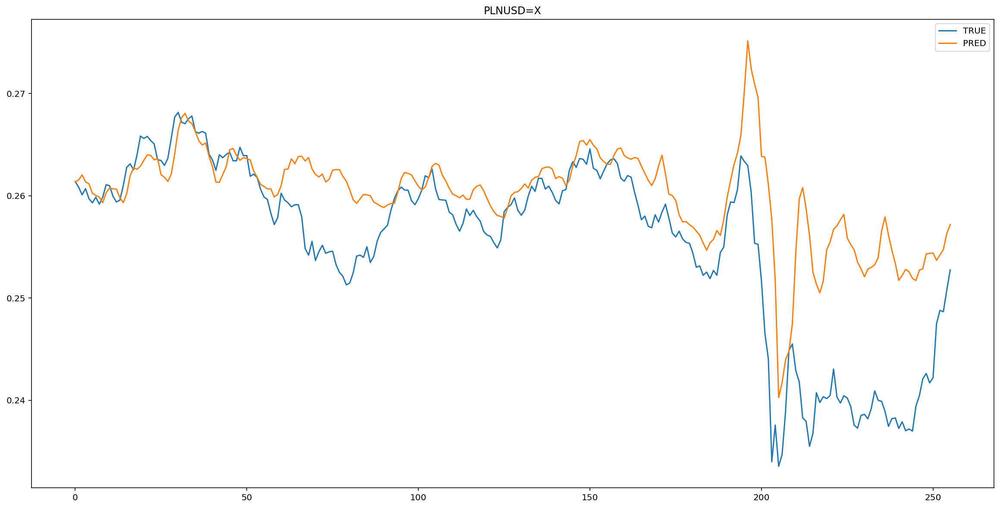

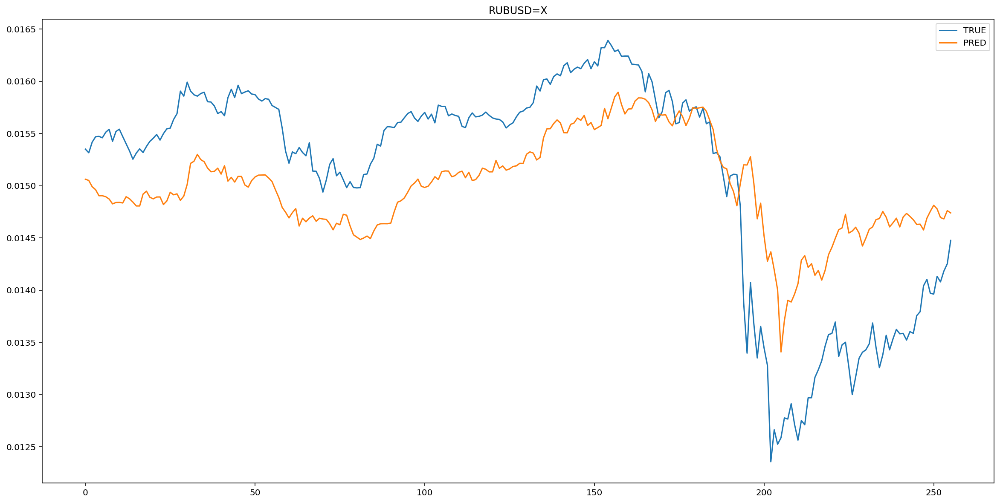

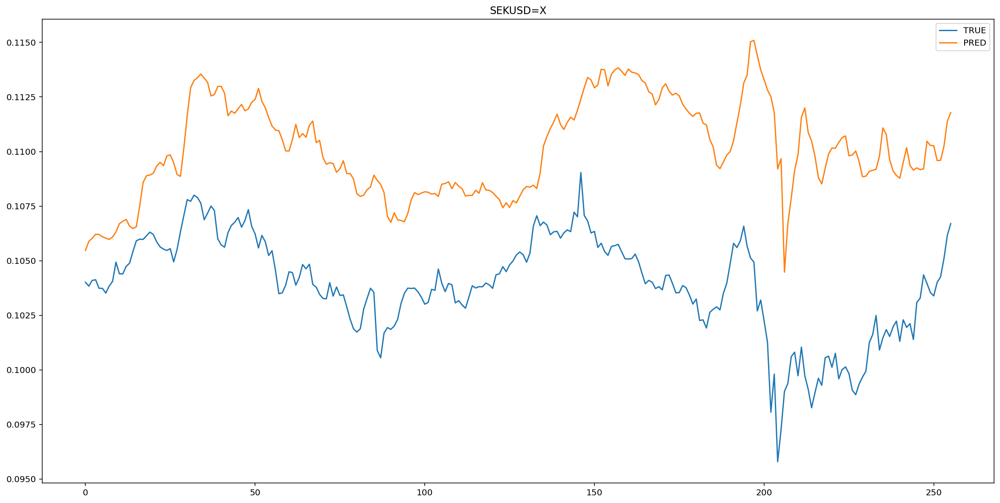

In [88]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

#####Оцениваем точность

In [89]:
table.loc['RNN'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

####LSTM

#####Вычисления

In [90]:
# design network
model = Sequential()
model.add(LSTM(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(LSTM(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 2s - loss: 0.3609 - val_loss: 0.1609
Epoch 2/100
5/5 - 0s - loss: 0.3191 - val_loss: 0.1370
Epoch 3/100
5/5 - 0s - loss: 0.2521 - val_loss: 0.0996
Epoch 4/100
5/5 - 0s - loss: 0.1439 - val_loss: 0.0522
Epoch 5/100
5/5 - 0s - loss: 0.0622 - val_loss: 0.0369
Epoch 6/100
5/5 - 0s - loss: 0.0507 - val_loss: 0.0341
Epoch 7/100
5/5 - 0s - loss: 0.0231 - val_loss: 0.0397
Epoch 8/100
5/5 - 0s - loss: 0.0280 - val_loss: 0.0389
Epoch 9/100
5/5 - 0s - loss: 0.0237 - val_loss: 0.0364
Epoch 10/100
5/5 - 0s - loss: 0.0220 - val_loss: 0.0344
Epoch 11/100
5/5 - 0s - loss: 0.0187 - val_loss: 0.0332
Epoch 12/100
5/5 - 0s - loss: 0.0180 - val_loss: 0.0323
Epoch 13/100
5/5 - 0s - loss: 0.0174 - val_loss: 0.0318
Epoch 14/100
5/5 - 0s - loss: 0.0167 - val_loss: 0.0319
Epoch 15/100
5/5 - 0s - loss: 0.0159 - val_loss: 0.0323
Epoch 16/100
5/5 - 0s - loss: 0.0151 - val_loss: 0.0325
Epoch 17/100
5/5 - 0s - loss: 0.0143 - val_loss: 0.0323
Epoch 18/100
5/5 - 0s - loss: 0.0134 - val_loss: 0.0319
E

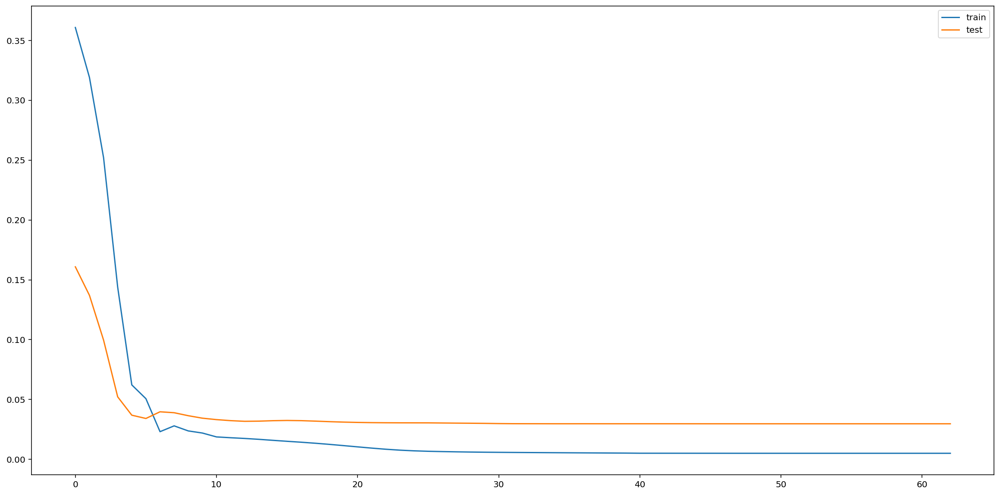

In [91]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [92]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

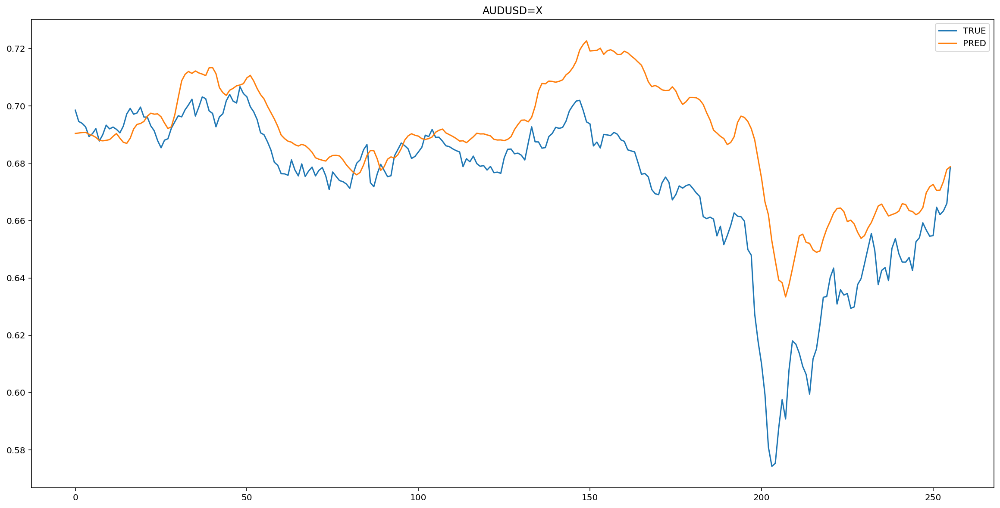

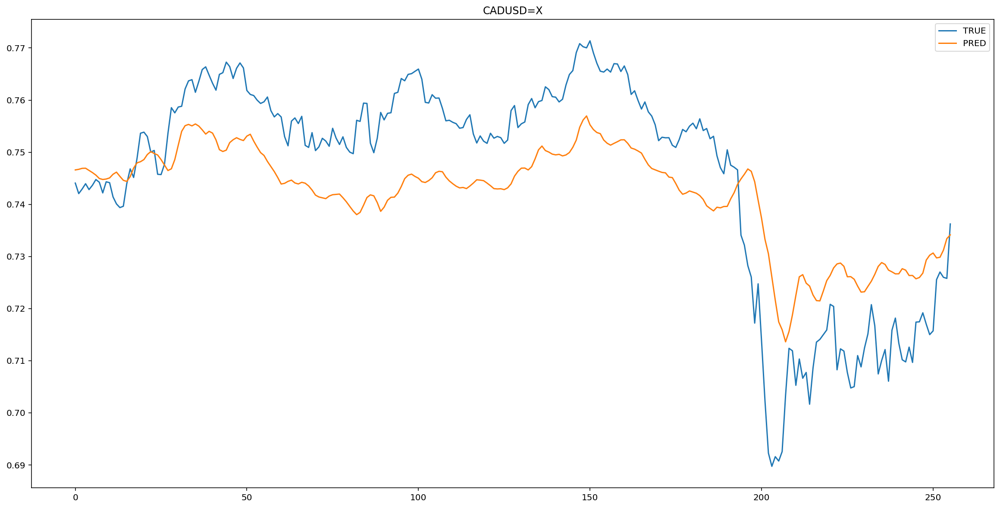

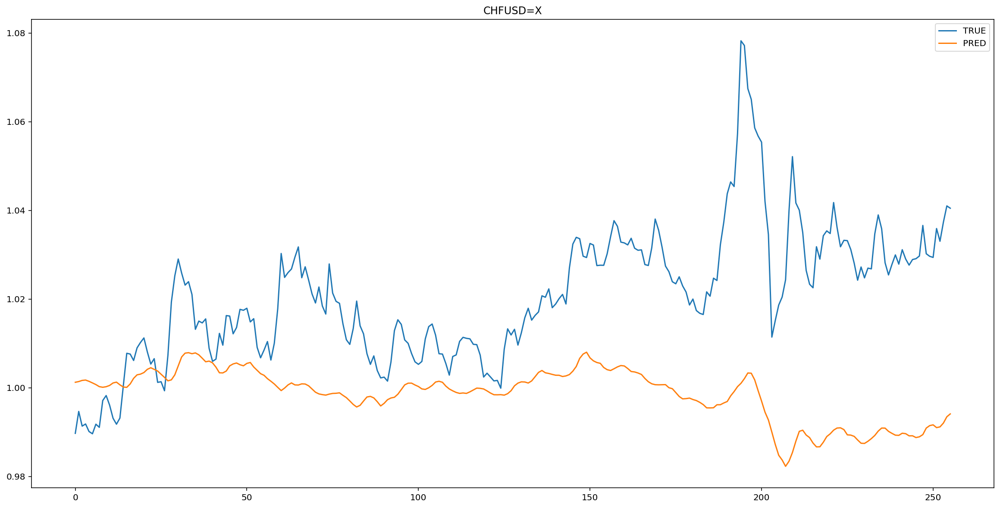

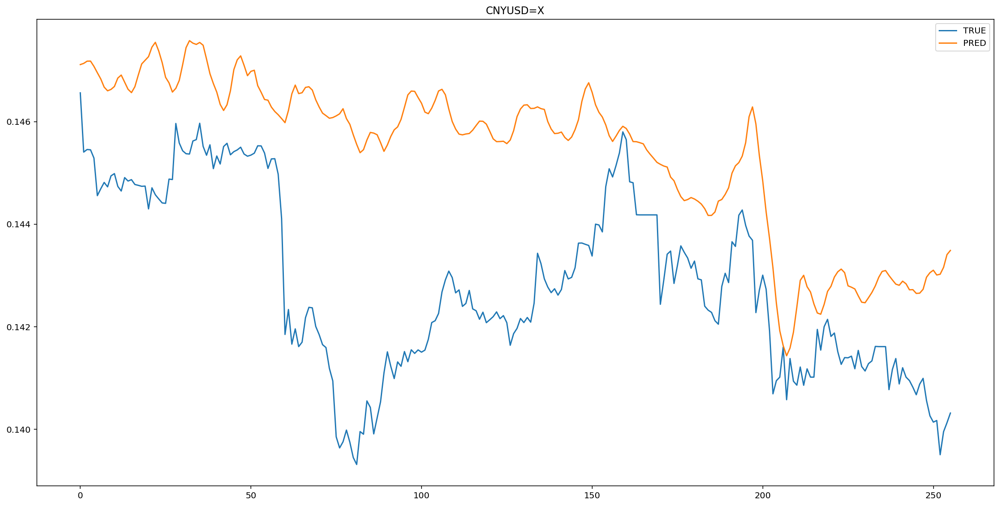

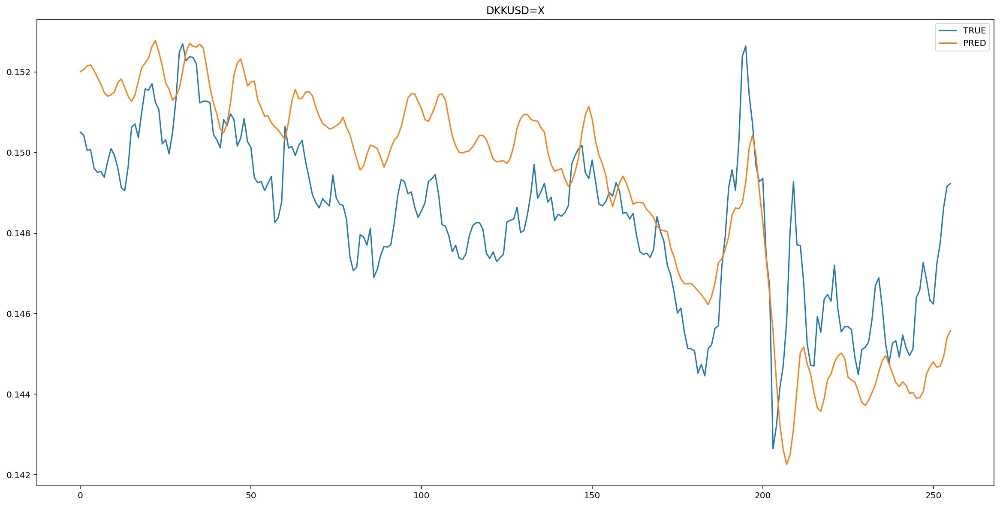

...

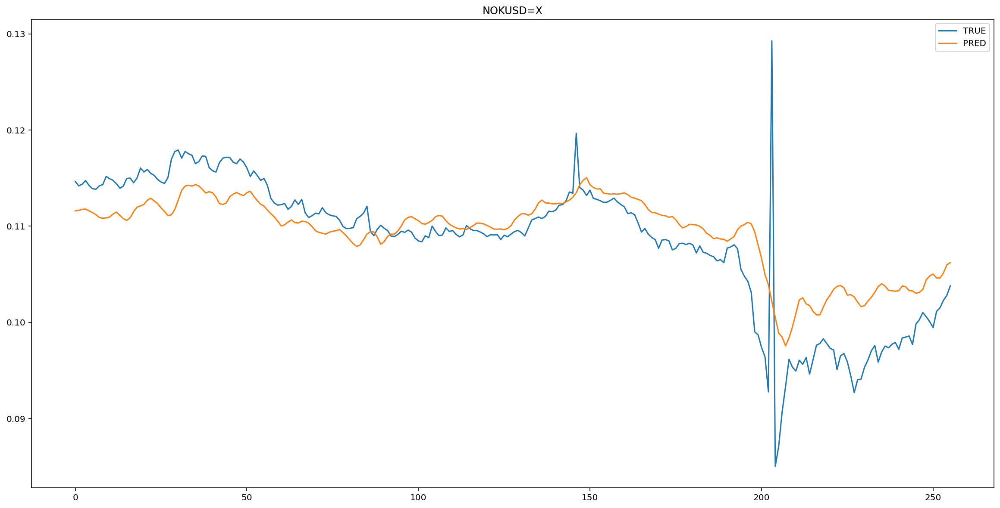

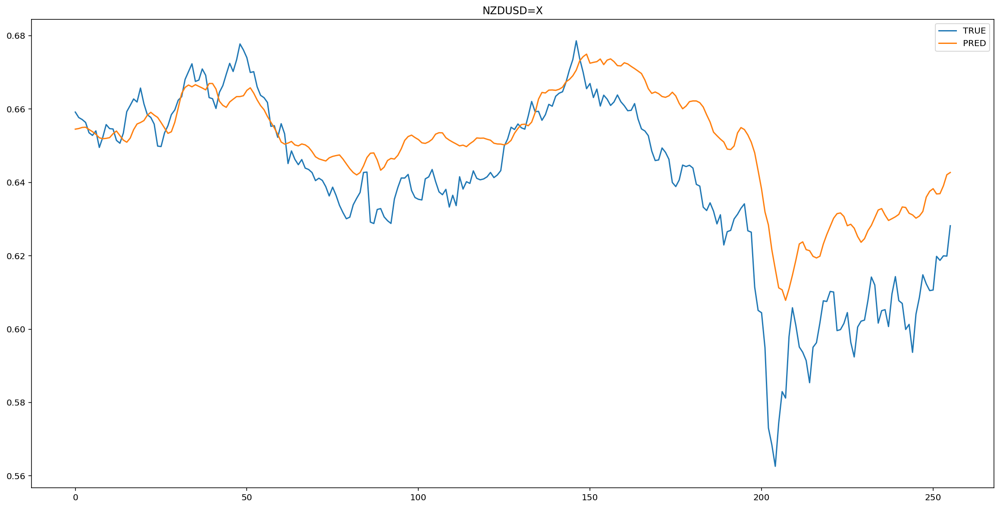

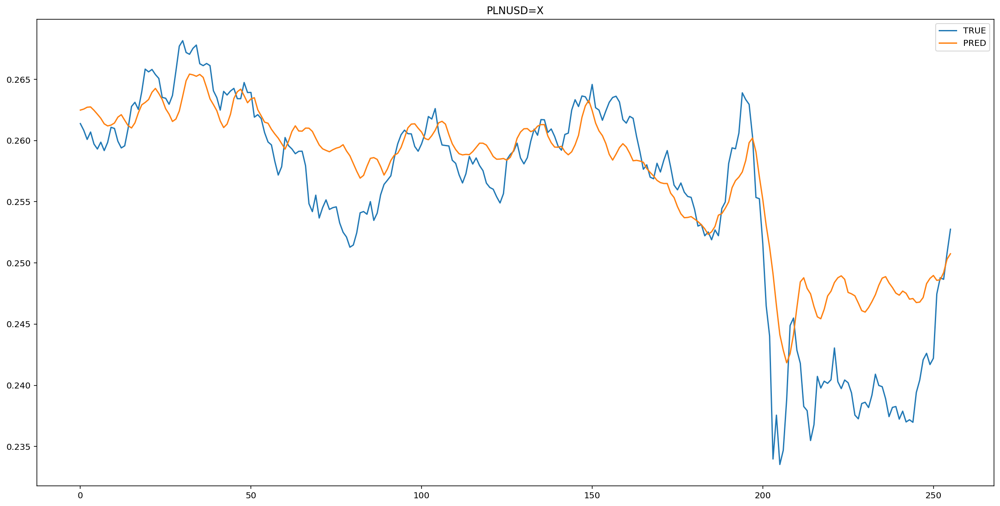

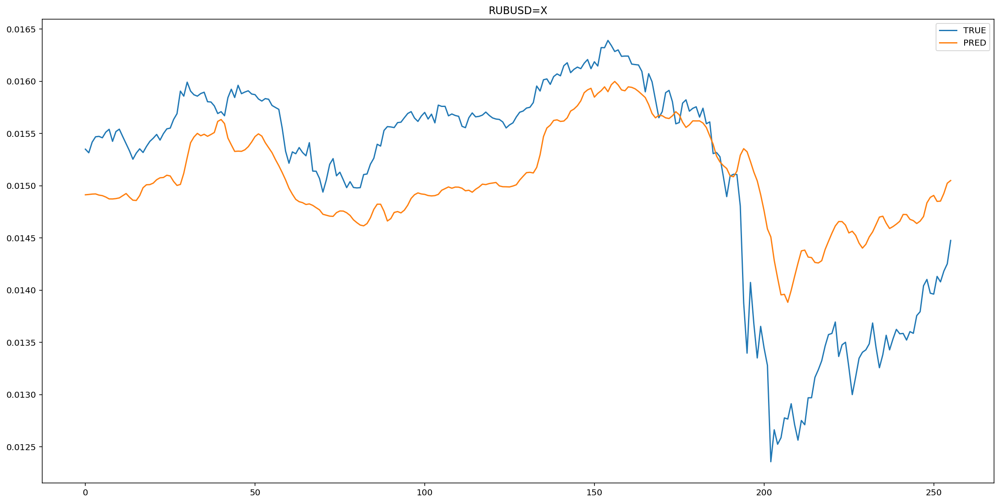

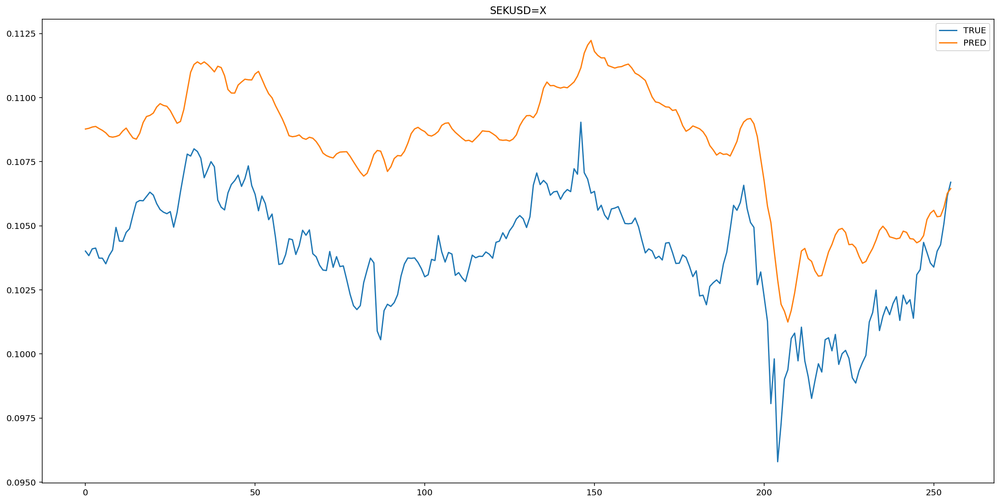

In [93]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

#####Оцениваем точность

####GRU

#####Вычисления

In [94]:
# design network
model = Sequential()
model.add(GRU(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(GRU(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 2s - loss: 0.3324 - val_loss: 0.1280
Epoch 2/100
5/5 - 0s - loss: 0.2250 - val_loss: 0.0816
Epoch 3/100
5/5 - 0s - loss: 0.1134 - val_loss: 0.0493
Epoch 4/100
5/5 - 0s - loss: 0.0452 - val_loss: 0.0616
Epoch 5/100
5/5 - 0s - loss: 0.0420 - val_loss: 0.0426
Epoch 6/100
5/5 - 0s - loss: 0.0192 - val_loss: 0.0347
Epoch 7/100
5/5 - 0s - loss: 0.0238 - val_loss: 0.0356
Epoch 8/100
5/5 - 0s - loss: 0.0225 - val_loss: 0.0386
Epoch 9/100
5/5 - 0s - loss: 0.0191 - val_loss: 0.0424
Epoch 10/100
5/5 - 0s - loss: 0.0184 - val_loss: 0.0409
Epoch 11/100
5/5 - 0s - loss: 0.0166 - val_loss: 0.0377
Epoch 12/100
5/5 - 0s - loss: 0.0162 - val_loss: 0.0364
Epoch 13/100
5/5 - 0s - loss: 0.0155 - val_loss: 0.0367

Epoch 00013: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
Epoch 14/100
5/5 - 0s - loss: 0.0145 - val_loss: 0.0367
Epoch 15/100
5/5 - 0s - loss: 0.0144 - val_loss: 0.0368
Epoch 16/100
5/5 - 0s - loss: 0.0143 - val_loss: 0.0368


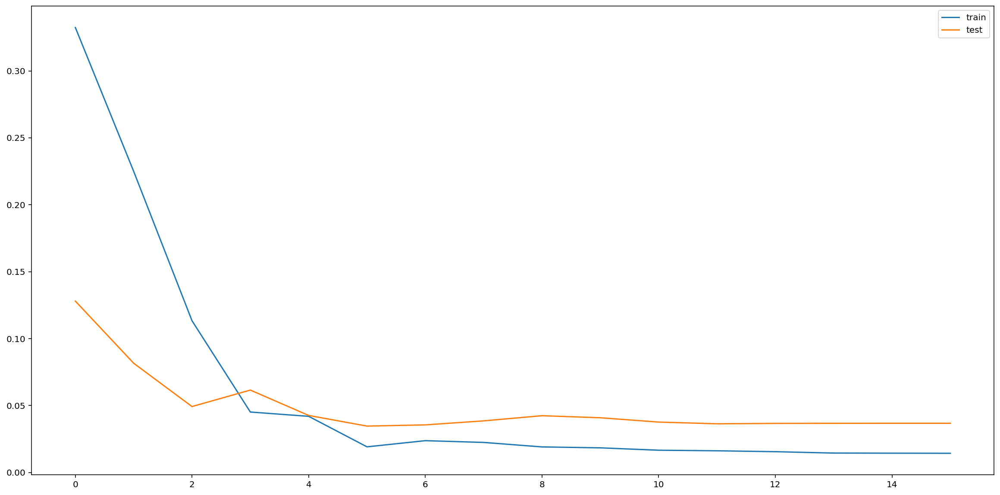

In [95]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [96]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

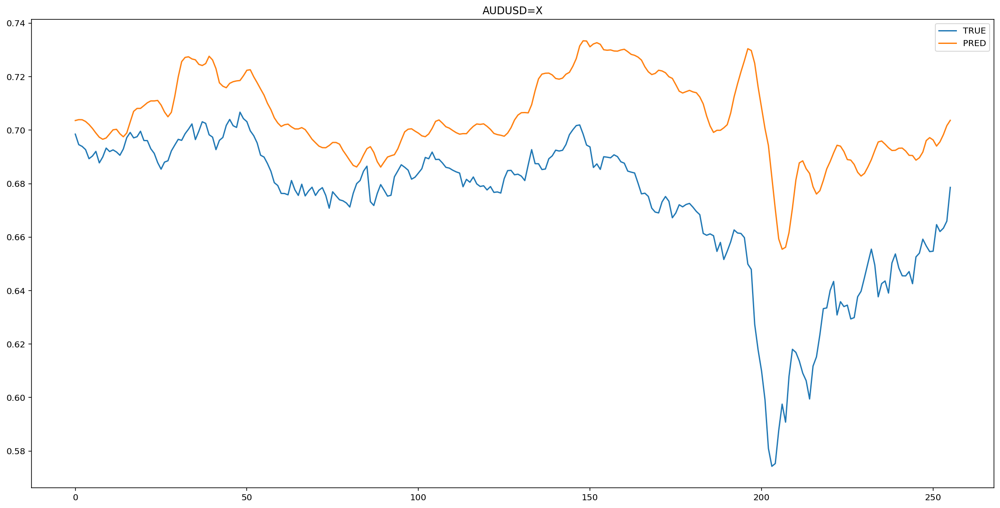

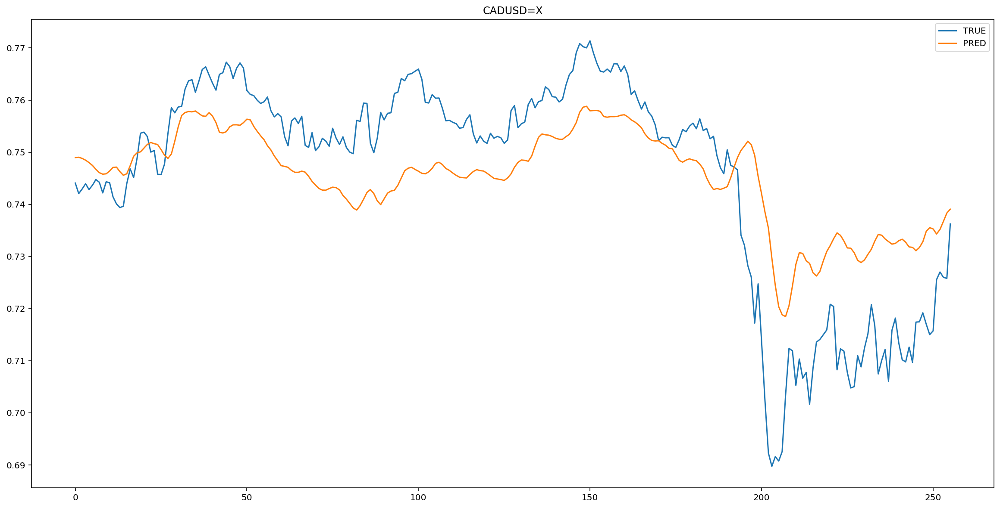

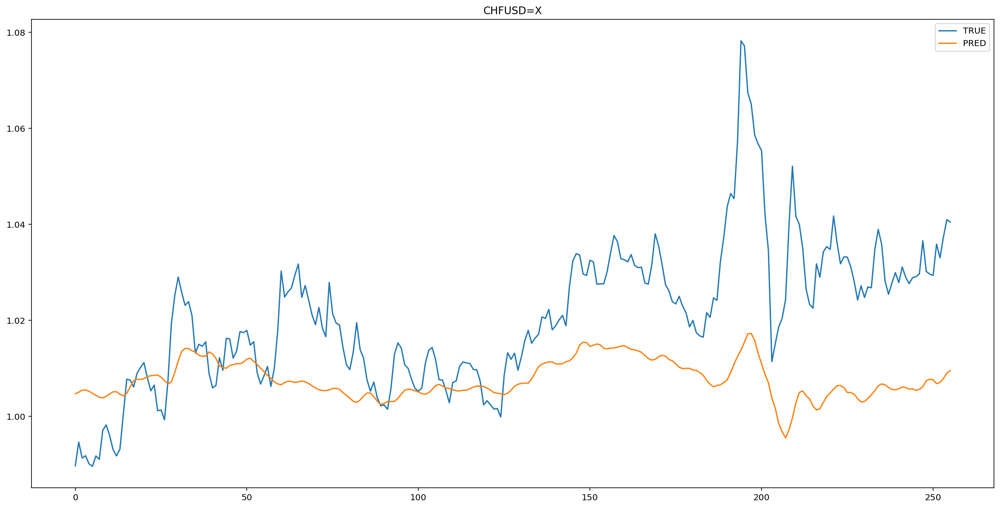

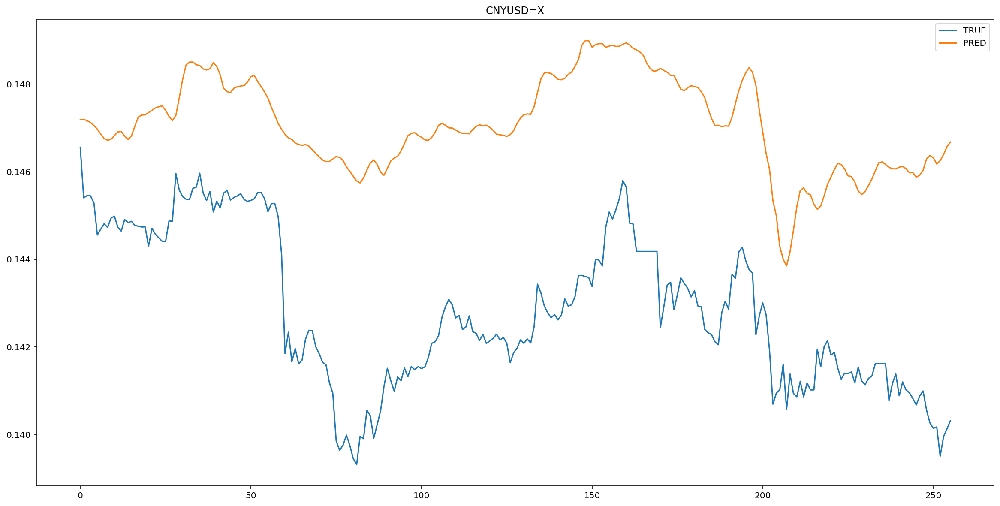

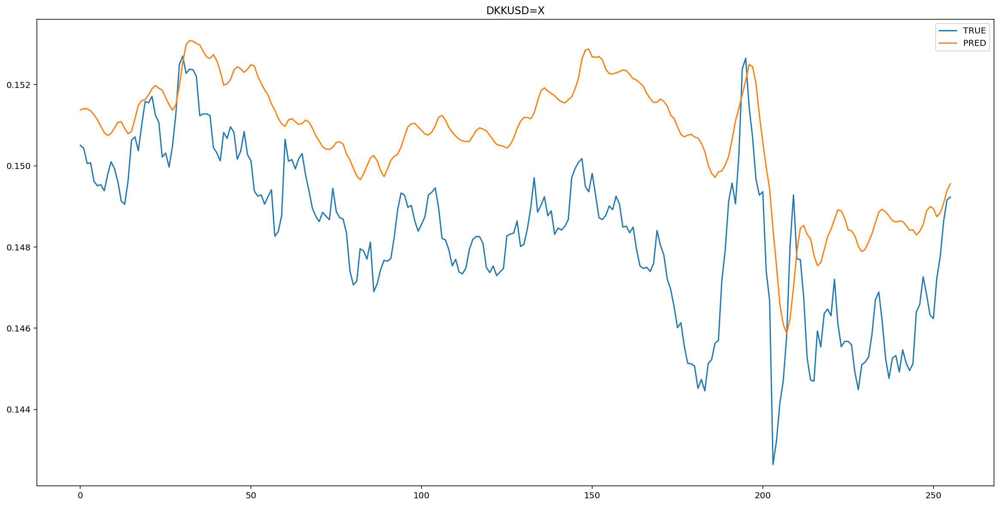

...

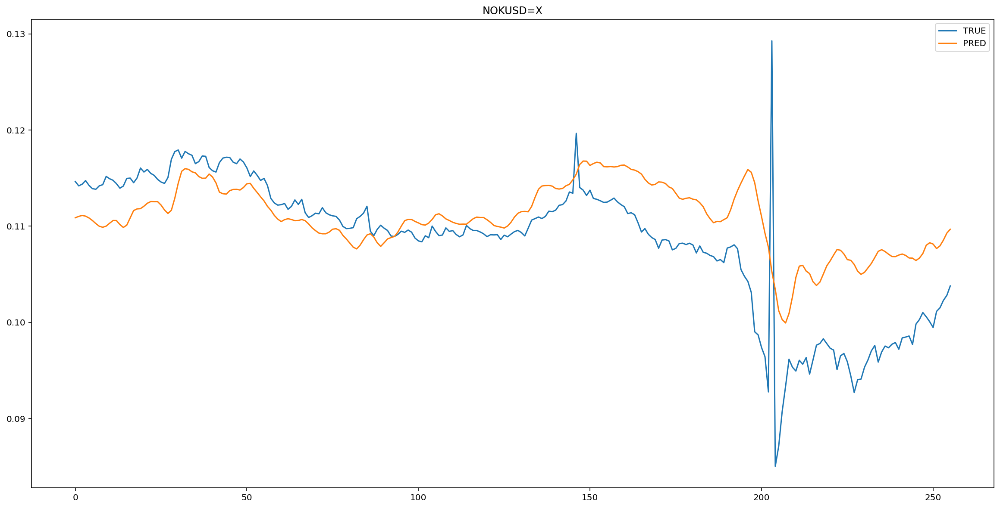

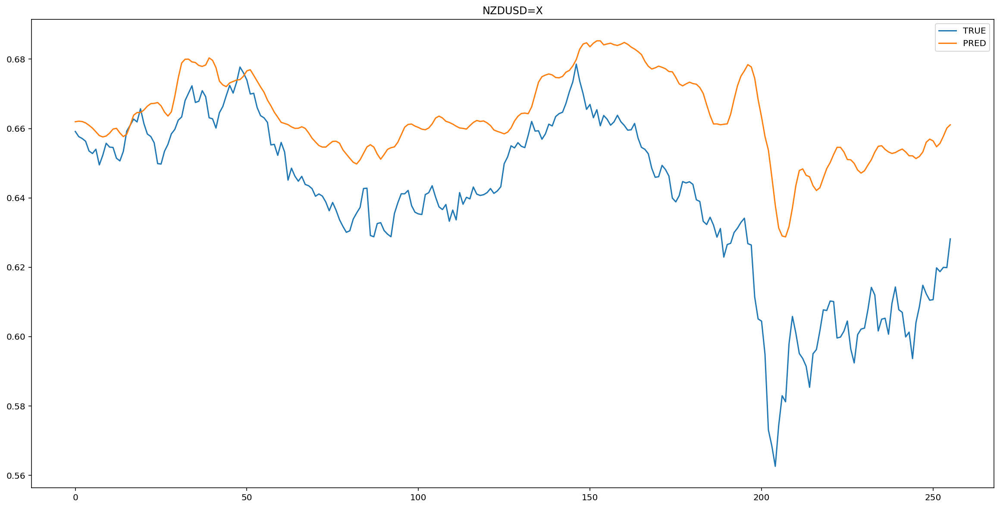

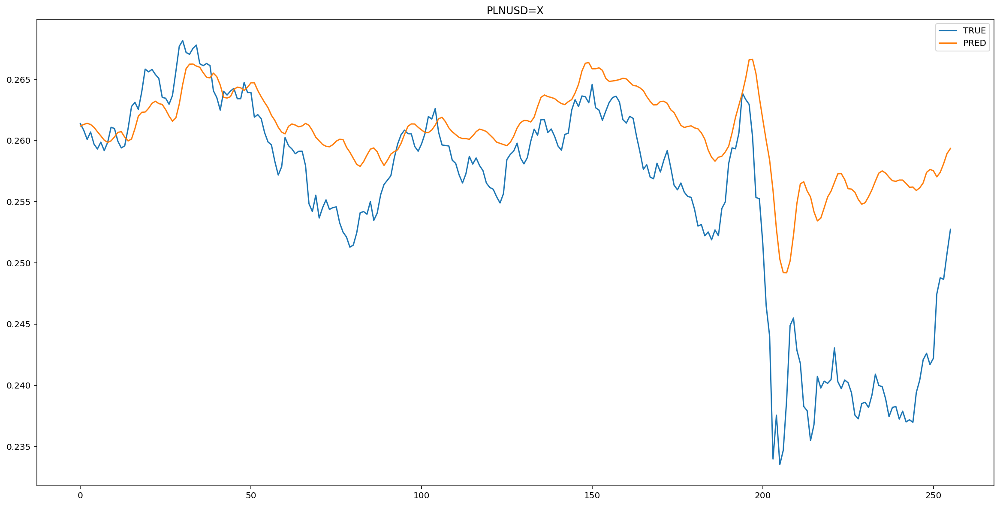

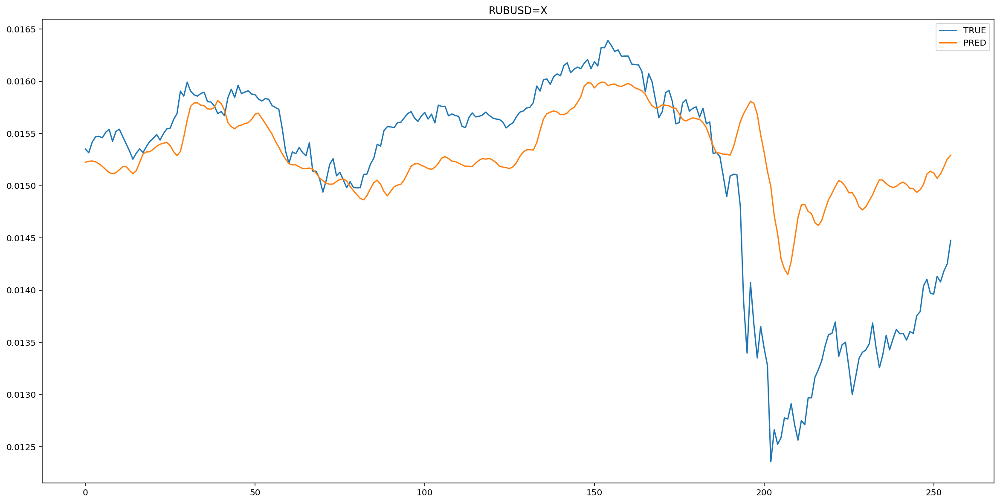

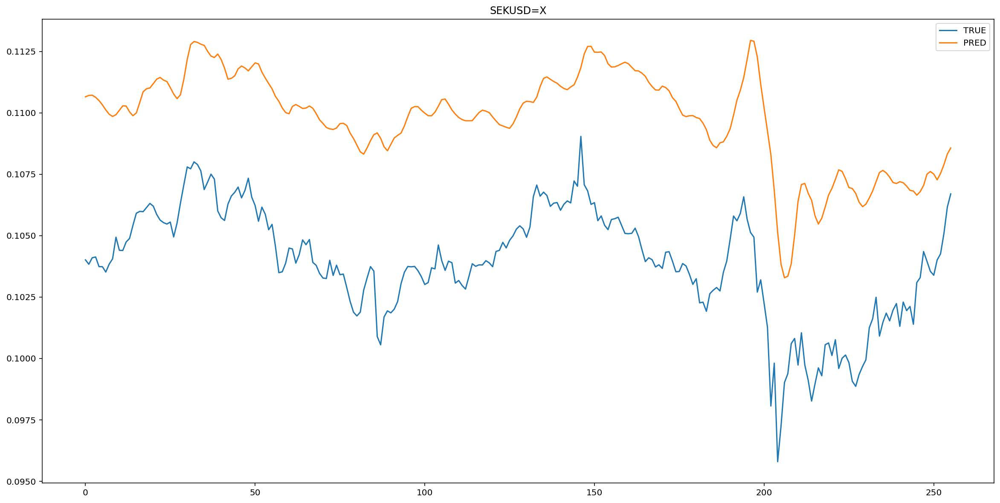

In [97]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

#####Оцениваем точность

####Комбинированные

#####Вычисления

#####Оцениваем точность

###Комбинации

####Вычисления

####Оцениваем точность

In [98]:
MSE(y_hat, y_pred)

0.00030022644

In [99]:
RMSE(y_hat, y_pred)

0.017327044

In [100]:
MAE(y_hat, y_pred)

0.010169373

#Сравнение

Таблица:

In [101]:
table

,MSE,RMSE,MAE
naive,0.000058,0.007617,0.003644
mean,0.000071,0.008430,0.003828
moving average,0.000071,0.008404,0.003816
VAR,0.000022,0.004690,0.002295
Perc,0.000143,0.011955,0.007165
Conv,0.000427,0.020674,0.011099
RNN,0.000252,0.015865,0.008836


#Версии

In [102]:
import os

In [103]:
os.system("apt update && apt install -y neofetch")
!neofetch

            .-/+oossssoo+/-. 
        `:+ssssssssssssssssss+:` 
      -+ssssssssssssssssssyyssss+- 
    .ossssssssssssssssssdMMMNysssso. 
   /ssssssssssshdmmNNmmyNMMMMhssssss/ 
  +ssssssssshmydMMMMMMMNddddyssssssss+ 
 /sssssssshNMMMyhhyyyyhmNMMMNhssssssss/ 
.ssssssssdMMMNhsssssssssshNMMMdssssssss. 
+sssshhhyNMMNyssssssssssssyNMMMysssssss+ 
ossyNMMMNyMMhsssssssssssssshmmmhssssssso 
ossyNMMMNyMMhsssssssssssssshmmmhssssssso 
+sssshhhyNMMNyssssssssssssyNMMMysssssss+ 
.ssssssssdMMMNhsssssssssshNMMMdssssssss. 
 /sssssssshNMMMyhhyyyyhdNMMMNhssssssss/ 
  +sssssssssdmydMMMMMMMMddddyssssssss+ 
   /ssssssssssshdmNNNNmyNMMMMhssssss/ 
    .ossssssssssssssssssdMMMNysssso. 
      -+sssssssssssssssssyyyssss+- 
        `:+ssssssssssssssssss+:` 
            .-/+oossssoo+/-. 
root@cc260788acd6 
----------------- 
OS: Ubuntu 18.04.5 LTS x86_64 
Host: Google Compute Engine 
Kernel: 4.19.112+ 
Uptime: 55 mins 
Packages: 1344 
Shell: bash 4.4.20 
Terminal: jupyter-noteboo 
CPU: Intel Xeon (2) @ 2.199GHz 
Mem

In [104]:
!python --version

Python 3.7.10


In [105]:
!pip freeze
!pip freeze > requirements.txt 

absl-py==0.10.0
alabaster==0.7.12
albumentations==0.1.12
altair==4.1.0
appdirs==1.4.4
argon2-cffi==20.1.0
asgiref==3.3.1
astor==0.8.1
astropy==4.2
astunparse==1.6.3
async-generator==1.10
atari-py==0.2.6
atomicwrites==1.4.0
attrs==20.3.0
audioread==2.1.9
autograd==1.3
Babel==2.9.0
backcall==0.2.0
beautifulsoup4==4.6.3
bleach==3.3.0
blis==0.4.1
bokeh==2.1.1
Bottleneck==1.3.2
branca==0.4.2
bs4==0.0.1
CacheControl==0.12.6
cachetools==4.2.1
catalogue==1.0.0
certifi==2020.12.5
cffi==1.14.5
chainer==7.4.0
chardet==3.0.4
click==7.1.2
cloudpickle==1.3.0
cmake==3.12.0
cmdstanpy==0.9.5
colorlover==0.3.0
community==1.0.0b1
contextlib2==0.5.5
convertdate==2.3.1
coverage==3.7.1
coveralls==0.5
crcmod==1.7
cufflinks==0.17.3
cupy-cuda101==7.4.0
cvxopt==1.2.6
cvxpy==1.0.31
cycler==0.10.0
cymem==2.0.5
Cython==0.29.22
daft==0.0.4
dask==2.12.0
datascience==0.10.6
debugpy==1.0.0
decorator==4.4.2
defusedxml==0.7.1
descartes==1.1.0
dill==0.3.3
distributed==1.25.3
Django==3.1.7
dlib==19.18.0
dm-tree==0.1.5
doc